# <center> AML 2203 - Advanced Python AI and ML Tools </center>

# Assignment #1 


### Group Members

- Aishlee C0913045
- Jayachandhran Saravanan
- Prashanta Timsina
- Rohan
- Yogita Sharma

# Step 1: Dataset Description 

For this assignment, we have scraped "computer" based books data.

In total, we have a dataset with 39,990 rows and 15 features, consisting of all predictive variables.

Each row in the dataset represents one unique book details corresponding to various attributes such as book ID, author, title, publisher, edition, etc. The features provided for each record are:

- __Title:__ the title of a book
- __id:__ an unique id for each book in the dataset
- __price:__ the price of the particular book
- __author:__ the author of the particular book
- __publisher:__ the publisher of the book
- __pub_year:__ the year in which the book was published
- __s_title:__ it's a subtitle what i guess (may be referred to a another title)
- __edition_num:__ the edition number of the book
- __description:__ a detailed description of the book
- __available:__ indicates the availability status, whether a book is in stock or not.
- __sale_date:__ the date of sale for the book
- __short_pub:__ sale date for the book in short (Jan 24) 
- __num_of_author:__ The number of authors associated with the book
- __width:__ width dimension of the book (in cm)
- __height:__ height dimension of the book (in cm)

# Step 2: Data Wrangling

Let's proceed to the second step and apply data wrangling steps. In this, we will __read__ our __dataset__ from the provided file in CSV format.

In this case, our __data source__ is API (...something from where you scraped the data idk ...) and will __gather data__ from this single source.

In [283]:
# import the necessary libraries for the analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from kneed import KneeLocator #need to be installed before running
from PIL import Image
from IPython.display import clear_output
from wordcloud import WordCloud, STOPWORDS
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from ydata_profiling import ProfileReport
import warnings
warnings.filterwarnings('ignore')
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from itertools import chain

In [2]:
# load the dataset
df = pd.read_csv('api_metod_40k_15_fields.csv')

# display the first 5 rows of the dataset
df.head()

,Title,id,price,author,publisher,pub_year,s_tile,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height
0,Learning Go,211190367,71.990000,Jon Bodner,O'Reilly Media,2024,NaN,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10T00:00:00,Jan 2024,1,97,150
1,Tidy First?,211127822,42.990000,Kent Beck,O'Reilly Media,2023,NaN,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17T00:00:00,Oct 2023,1,97,150
2,"Hands-On Machine Learning with Scikit-Learn, K...",210681725,96.990000,Aurélien Géron,O'Reilly Media,2022,NaN,(3rd ed.),"Through a recent series of breakthroughs, deep...",True,2022-10-04T00:00:00,Oct 2022,1,97,150
3,Designing Data-Intensive Applications,95729334,67.990000,Martin Kleppmann,O'Reilly Media,2017,"The Big Ideas Behind Reliable, Scalable, and M...",NaN,Data is at the center of many challenges in sy...,True,2017-03-16T00:00:00,Mar 2017,1,97,150
4,Exam Ref MS-102 Microsoft 365 Administrator,210964419,53.862731,Orin Thomas,Pearson Education,2023,NaN,NaN,Prepare for Microsoft Exam MS-102 and help dem...,True,2023-10-18T00:00:00,Oct 2023,1,97,150


In [3]:
# dimension (rows and columns) of the dataset

print(f"Number of rows: {df.shape[0]}")
print(f"Number of columns: {df.shape[1]}")
print(f"Shape (rows, columns): {df.shape}")

Number of rows: 39990
Number of columns: 15
Shape (rows, columns): (39990, 15)


As we can see, our dataset has 39,990 rows and 15 columns.

Let's check our variables data types and look for corrupted data that we can filter out.

In [4]:
# data types of each colummn of our dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39990 entries, 0 to 39989
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Title          39990 non-null  object 
 1   id             39990 non-null  int64  
 2   price          39881 non-null  float64
 3   author         39981 non-null  object 
 4   publisher      39990 non-null  object 
 5   pub_year       39990 non-null  int64  
 6   s_tile         26656 non-null  object 
 7   edition_num    3613 non-null   object 
 8   description    34382 non-null  object 
 9   availabe       39990 non-null  bool   
 10  sale_date      39990 non-null  object 
 11  short_pub      39990 non-null  object 
 12  num_of_author  39990 non-null  int64  
 13  width          39990 non-null  int64  
 14  height         39990 non-null  int64  
dtypes: bool(1), float64(1), int64(5), object(8)
memory usage: 4.3+ MB


In [5]:
# checking for null or missing values
df.isnull().sum()

Title                0
id                   0
price              109
author               9
publisher            0
pub_year             0
s_tile           13334
edition_num      36377
description       5608
availabe             0
sale_date            0
short_pub            0
num_of_author        0
width                0
height               0
dtype: int64

There are missing values in the price, s_title, edition_num and description columns.

Now, we gonna check the unique values for each column.

In [6]:
# Checking the unique values in each column
for col in df:
  print(f"\033[94mUnique values in '{col}' column:")
  print(df[col].unique(), end='\n\n')

Unique values in 'Title' column:
['Learning Go' 'Tidy First?'
 'Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow' ...
 'Charting the Topic Maps Research and Applications Landscape'
 'Data Mining for Biomedical Applications'
 'PRICAI 2006: Trends in Artificial Intelligence']

Unique values in 'id' column:
[211190367 211127822 210681725 ...   2476718   2476736   2476777]

Unique values in 'price' column:
[ 71.99        42.99        96.99       ... 104.5515523   12.19162646
  95.04818674]

Unique values in 'author' column:
['Jon Bodner' 'Kent Beck' 'Aurélien Géron' ... 'Simon D. Parsons'
 'Quiang Yang' 'Jérôme Lang']

Unique values in 'publisher' column:
["O'Reilly Media" 'Pearson Education' 'McGraw Hill LLC'
 'Make Community, LLC' 'Cambridge University Press' 'Elluminet Press'
 'Wiley' 'BCS Learning & Development Limited' 'Pragmatic Bookshelf'
 'Flatiron Books' 'Packt Publishing' 'Certification Experts, LLC'
 'CRC Press' 'Vytautas Alechnavicius' 'Skill Recordings Inc'
 

In [7]:
# make a list of the variables that contain missing values
vars_with_na = [var for var in df.columns if df[var].isnull().sum() > 0]

# determine percentage of missing values (expressed as decimals)
# and display the result ordered by % of missin data
df[vars_with_na].isnull().mean().sort_values(ascending = False) * 100

edition_num    90.965241
s_tile         33.343336
description    14.023506
price           0.272568
author          0.022506
dtype: float64

Now we can clearly identify that the '__edition_num__', '__s_title__', '__description__', '__price__' and '__author__' columns have a considerable amount of __missing values.__

Let's __drop 's_title' column__ to filter out the corrupted data as it won't add any value to our data.

In [8]:
# Let's drop the columns with missing values
df.drop(columns = ['s_tile'], inplace = True)

In [9]:
# checking again for null or missing values
df.isnull().sum()

Title                0
id                   0
price              109
author               9
publisher            0
pub_year             0
edition_num      36377
description       5608
availabe             0
sale_date            0
short_pub            0
num_of_author        0
width                0
height               0
dtype: int64

In [10]:
df.isnull().sum().sum()

42103

In [11]:
# Print the number of duplicated rows
print("Number of duplicated rows:", df[df.duplicated()].shape[0])

Number of duplicated rows: 9156


In [12]:
# Visualize some duplicated rows
df[df.duplicated()].head()

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height
30,Getting Started with Processing,2208258,14.99000,Casey Reas,"Make Community, LLC",2015,(2nd ed.),Processing opened up the world of programming ...,True,2015-09-09T00:00:00,Sep 2015,2,97,150
60,REST API Design Rulebook,801433,10.99000,Mark Masse,O'Reilly Media,2011,NaN,"In today’s market, where rival web services co...",True,2011-10-18T00:00:00,Oct 2011,1,97,150
90,(ISC)2 CISSP Certified Information Systems Sec...,210320755,50.00000,Mike Chapple,Wiley,2021,(3rd ed.),Full-length practice tests covering all CISSP ...,True,2021-06-16T00:00:00,Jun 2021,2,97,150
140,Fluent C,210689032,71.99000,Christopher Preschern,O'Reilly Media,2022,NaN,Expert advice on C programming is hard to find...,True,2022-10-17T00:00:00,Oct 2022,1,97,150
180,"CISSP All-in-One Exam Guide, Ninth Edition",210393469,94.28335,Fernando Maymi,McGraw Hill LLC,2021,(9th ed.),A new edition of Shon Harris’ bestselling exam...,True,2021-11-12T00:00:00,Nov 2021,2,97,150


In [13]:
# Let's get rid of duplicate entries

df.drop_duplicates(keep = 'first', inplace = True)

# Again check the dataset shape, after removing the duplicate entries

print(f'\033[94mNumber of records (rows) in the dataset are: {df.shape[0]}')
print(f'\033[94mNumber of features (columns) in the dataset are: {df.shape[1]}')

Number of records (rows) in the dataset are: 30834
Number of features (columns) in the dataset are: 14


We have eliminated 24 duplicated rows.

Now, let's identify our numerical and categorical variables so we can perform further text preprocessing upon them.

In [14]:
# Show columns names
df.columns

Index(['Title', 'id', 'price', 'author', 'publisher', 'pub_year',
       'edition_num', 'description', 'availabe', 'sale_date', 'short_pub',
       'num_of_author', 'width', 'height'],
      dtype='object')

In [15]:
numerical_columns = [col for col in df.columns if df[col].dtypes!='O']
categorical_columns = [col for col in df.columns if df[col].dtypes=='O']

print("Number of Numerical Features:   ", len(numerical_columns))
print("Numerical Features:   ", end = '')
print(numerical_columns)
print("\nNumber of Categorical Features:   ", len(categorical_columns))
print("Categorical Features: ", end = '')
print(categorical_columns)

Number of Numerical Features:    7
Numerical Features:   ['id', 'price', 'pub_year', 'availabe', 'num_of_author', 'width', 'height']

Number of Categorical Features:    7
Categorical Features: ['Title', 'author', 'publisher', 'edition_num', 'description', 'sale_date', 'short_pub']


## Let's start Text Preprocessing on 'categorical' variables

### Creating Functions for Text cleansing:

- removal of emojis
- conversion of float to string (if text data has float value)
- convert to lower case.
- length of the Text.
- usernames removal if there's any
- removing Digits.
- removing all single characters
- punctuation and special characters removal
- convert more than 2 letter repetitions to 2 letter
- removing meaningless words

__Function__ to handle __emoji classification__ (if there is any in text)

In [16]:
def emoji(title_data):
    title_data = re.sub(r'(:\s?\)|:-\)|\(\s?:|\(-:|:\'\)|:O)', ' positiveemoji ', title_data)
    title_data = re.sub(r'(:\s?D|:-D|x-?D|X-?D)', ' positiveemoji ', title_data)
    title_data = re.sub(r'(<3|:\*)', ' positiveemoji ', title_data)
    title_data = re.sub(r'(;-?\)|;-?D|\(-?;|@-\))', ' positiveemoji ', title_data)
    title_data = re.sub(r'(:\s?\(|:-\(|\)\s?:|\)-:|:-/|:-\|)', ' negetiveemoji ', title_data)
    title_data = re.sub(r'(:,\(|:\'\(|:"\()', ' negetiveemoji ', title_data)
    return title_data

__Function__ to __clean__ the __'title' and 'description'__ column

In [17]:
def process_title(title_data):
    if isinstance(title_data, float):                       # Convert float to string if title_data has a float value
        title_data = "{:.2f}".format(title_data)            # Adjust the precision as needed
    else:
        title_data = str(title_data)
    title_data = title_data.lower()                                             # Lowercases the string
    title_data = re.sub('@[^\s]+', '', title_data)                              # Removes usernames
    title_data = re.sub('((www\.[^\s]+)|(https?://[^\s]+))', ' ', title_data)   # Remove URLs
    title_data = re.sub(r"\d+", " ", str(title_data))                           # Removes all digits
    title_data = re.sub('&quot;'," ", title_data)                               # Remove (&quot;) 
    title_data = emoji(title_data)                                              # Replaces Emojis
    title_data = re.sub(r"\b[a-zA-Z]\b", "", str(title_data))                   # Removes all single characters
    title_data = re.sub(r"[^\w\s]", " ", str(title_data))                       # Removes all punctuations
    title_data = re.sub(r'(.)\1+', r'\1\1', title_data)                         # Convert more than 2 letter repetitions to 2 letter
    title_data = re.sub(r"\s+", " ", str(title_data))                           # Replaces double spaces with single space    
    return title_data

__Function__ to check if the __spelling is correct or not__

In [18]:
def remove_meaningless(df, col):
      df[col] = df[col].apply(lambda x: TextBlob(x).correct())

__Function__ to check __stopwords__ as well as remove them

In [19]:
s_words = list(stopwords.words('english'))
from collections import Counter
c = Counter()

extra_s= ["what", "us", "this","well","there","much","us","and","you're","in","where","when","just","how","is","ha","re","are",
          "hi","aren't", 'couldn','could','couldnt',"couldn't",'did','had','have','must','does','should','was',"it's",
          "didn't", "doesn't", "don't", "hadn't", "hasn't", "haven't", "isn't", 'let', 'll',"may",'were','is','has','must',
          'mustn', 'rt', 'shan', 'shouldn', 'wasn', 'weren', 'won', 'wouldn','realli','now','got','man','people','a',
          'becaus','caus',"one","im","guy","someone","two",'read', "nearby","i","he's","she's","we","it","they","wouldn’t","i've", 'publications', 'publication',
          'aren', 'didn', 'doesn', 'don','amazon','good', 'content', 'hadn', 'hasn','star', 'haven', 'isn','great', 'subscription', 'sdidn', 've','article','subscribe', 'articles',"will","magazine","magazines","author",'writer','review','pages','issue','document']

stop_words = list(STOPWORDS) + list(s_words) + list(extra_s)

def remove_stopwords(df, column):
      df[column] = df[column].apply(lambda x: ' '.join([word for word in x.split() if word.lower() not in stop_words ]))

__Adding new columns to our original data__

In [20]:
df['processed_title'] = np.vectorize(process_title)(df['Title'])

In [21]:
df.head(2)

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title
0,Learning Go,211190367,71.99,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10T00:00:00,Jan 2024,1,97,150,learning go
1,Tidy First?,211127822,42.99,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17T00:00:00,Oct 2023,1,97,150,tidy first


In [22]:
df['processed_description'] = np.vectorize(process_title)(df['description'])

In [23]:
remove_stopwords(df = df, column = 'processed_description')

In [24]:
df.head(2)

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title,processed_description
0,Learning Go,211190367,71.99,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10T00:00:00,Jan 2024,1,97,150,learning go,go rapidly become preferred language building ...
1,Tidy First?,211127822,42.99,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17T00:00:00,Oct 2023,1,97,150,tidy first,tidying messy software means breaking code mak...


In [25]:
# Removing the hyphen from the 'short_pub' column's values
df['short_pub'] = df['short_pub'].str.replace('-', ' ')

In [26]:
df.head(2)

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title,processed_description
0,Learning Go,211190367,71.99,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10T00:00:00,Jan 2024,1,97,150,learning go,go rapidly become preferred language building ...
1,Tidy First?,211127822,42.99,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17T00:00:00,Oct 2023,1,97,150,tidy first,tidying messy software means breaking code mak...


In [27]:
# Convert the 'sale_date' column to datetime if it's not already in datetime format
df['sale_date'] = pd.to_datetime(df['sale_date'])

# Extract the time components from the 'sale_date' feature
df['hours'] = df['sale_date'].dt.hour
df['minutes'] = df['sale_date'].dt.minute
df['seconds'] = df['sale_date'].dt.second

In [28]:
df.head(2)

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title,processed_description,hours,minutes,seconds
0,Learning Go,211190367,71.99,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10,Jan 2024,1,97,150,learning go,go rapidly become preferred language building ...,0,0,0
1,Tidy First?,211127822,42.99,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17,Oct 2023,1,97,150,tidy first,tidying messy software means breaking code mak...,0,0,0


In [29]:
# Round off the 'price' column to two decimal places
df['updated_price'] = df['price'].round(2)

In [30]:
df.head(2)

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title,processed_description,hours,minutes,seconds,updated_price
0,Learning Go,211190367,71.99,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10,Jan 2024,1,97,150,learning go,go rapidly become preferred language building ...,0,0,0,71.99
1,Tidy First?,211127822,42.99,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17,Oct 2023,1,97,150,tidy first,tidying messy software means breaking code mak...,0,0,0,42.99


In [31]:
# Create a new column 'edition' which will have only only book edition number
df['edition'] = df['edition_num'].str.extract(r'(\d+)')

In [32]:
df.head(2)

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,...,num_of_author,width,height,processed_title,processed_description,hours,minutes,seconds,updated_price,edition
0,Learning Go,211190367,71.99,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10,...,1,97,150,learning go,go rapidly become preferred language building ...,0,0,0,71.99,2
1,Tidy First?,211127822,42.99,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17,...,1,97,150,tidy first,tidying messy software means breaking code mak...,0,0,0,42.99,NaN


# Step 3: Data Visualization

Let's explore the variables and find how they are distributed across our dataset.

Firstly, we gonna plot __'Book's Publication Distribution'__ as per __'Years'__

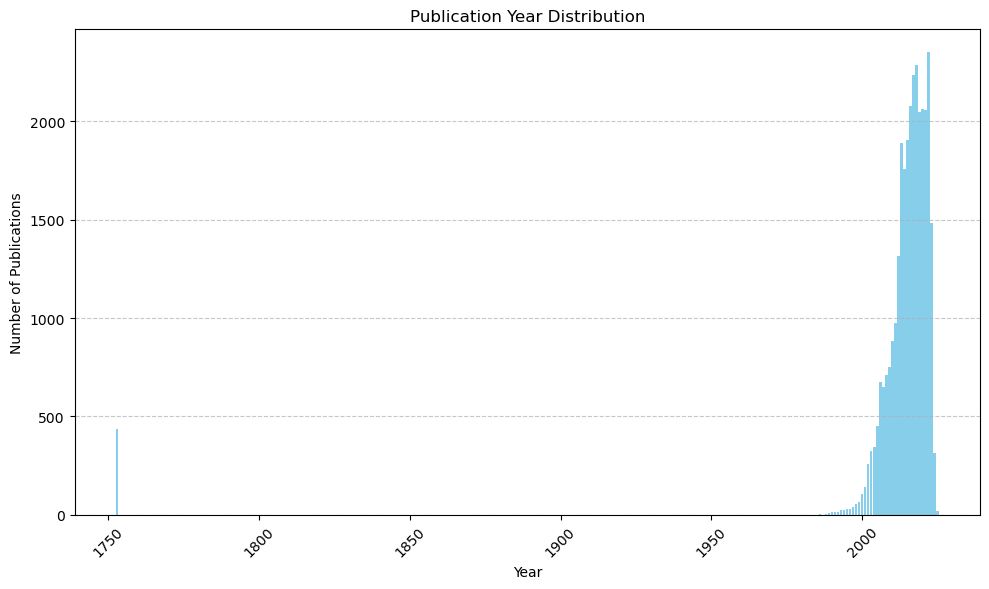

In [33]:
# Count the occurrences of each year
year_counts = df['pub_year'].value_counts().sort_index()

# Plot
plt.figure(figsize = (10, 6))
plt.bar(year_counts.index, year_counts.values, color = 'skyblue')
plt.title('Publication Year Distribution')
plt.xlabel('Year')
plt.ylabel('Number of Publications')
plt.xticks(rotation = 45) 
plt.grid(axis = 'y', linestyle = '--', alpha = 0.7)
plt.tight_layout()
plt.show()

In [34]:
year_counts

1753     438
1980       1
1986       4
1987       1
1988       6
1989       9
1990      12
1991      15
1992      12
1993      22
1994      22
1995      31
1996      29
1997      39
1998      55
1999      67
2000     104
2001     143
2002     256
2003     324
2004     345
2005     452
2006     677
2007     647
2008     710
2009     749
2010     882
2011     973
2012    1315
2013    1890
2014    1760
2015    1904
2016    2080
2017    2233
2018    2285
2019    2047
2020    2065
2021    2058
2022    2350
2023    1485
2024     316
2025      21
Name: pub_year, dtype: int64

In [35]:
# Bar Plot
plt.figure(figsize=(12, 6))
ax = sns.countplot(x = 'pub_year', data = df)
ax.set_title('Publication Year Distribution (2000-2024)')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Publications')
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
sns.despine()

In [36]:
plt.figure(figsize=(18, 7))
ax = sns.countplot(x = 'pub_year', data = df)
ax.set_title('Publication Year Distribution (2000-2024)', fontdict = {'fontsize': 22})
ax.set_xlabel('Year', fontdict = {'fontsize': 20})
ax.set_ylabel('Number of Publications', fontdict={'fontsize': 16})
ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, ha = 'right')
sns.despine()

# Add count values on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 3), textcoords = 'offset points')

According to the book's publication year data, 
- the highest number of computer books were published in the year '2022' i.e., 2350, followed by 2285 in '2018'
- only one book was published in two years (1980 and 1987)
- However, 316 books were published till now in this year
- Insignificant data for the year 2025 as it is yet to publish

Now, we will plot the __'number of books'__ belonging to the particular __'price'__ ranges

In [37]:
list(df['updated_price'])

[71.99,
 42.99,
 96.99,
 67.99,
 53.86,
 80.81,
 53.86,
 42.99,
 67.99,
 84.99,
 84.99,
 71.99,
 84.99,
 74.99,
 84.99,
 71.99,
 84.99,
 84.99,
 71.99,
 84.99,
 58.99,
 71.99,
 84.99,
 49.99,
 84.99,
 59.99,
 84.99,
 74.99,
 84.99,
 14.99,
 79.99,
 84.99,
 84.99,
 71.99,
 56.99,
 76.91,
 71.99,
 71.99,
 27.99,
 6.99,
 59.99,
 84.99,
 84.99,
 71.99,
 84.99,
 59.99,
 52.07,
 67.99,
 59.99,
 96.99,
 71.99,
 57.13,
 84.99,
 67.99,
 71.99,
 59.99,
 63.99,
 63.99,
 10.99,
 64.09,
 49.99,
 71.99,
 71.99,
 71.99,
 16.99,
 71.99,
 67.35,
 59.99,
 71.99,
 84.99,
 71.99,
 74.99,
 84.99,
 59.99,
 59.99,
 71.99,
 71.99,
 71.99,
 71.99,
 71.99,
 71.99,
 80.99,
 48.48,
 48.48,
 59.99,
 11.99,
 71.99,
 50.0,
 67.99,
 71.99,
 76.0,
 74.99,
 71.99,
 63.99,
 49.99,
 71.99,
 59.99,
 71.99,
 98.55,
 71.99,
 45.99,
 42.99,
 64.64,
 59.99,
 71.99,
 71.99,
 49.99,
 71.99,
 47.99,
 80.81,
 84.99,
 56.99,
 71.99,
 13.99,
 102.01,
 32.99,
 84.99,
 71.99,
 35.99,
 71.99,
 71.99,
 71.99,
 84.99,
 96.99,
 59.99,
 6

In [38]:
print(min(df['updated_price']))
print(max(df['updated_price']))

0.0
2353.37


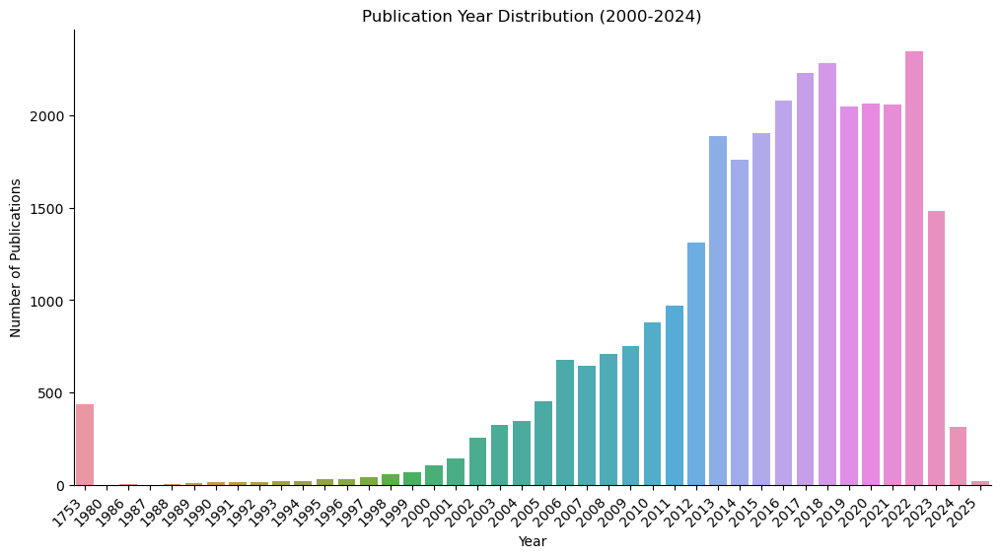

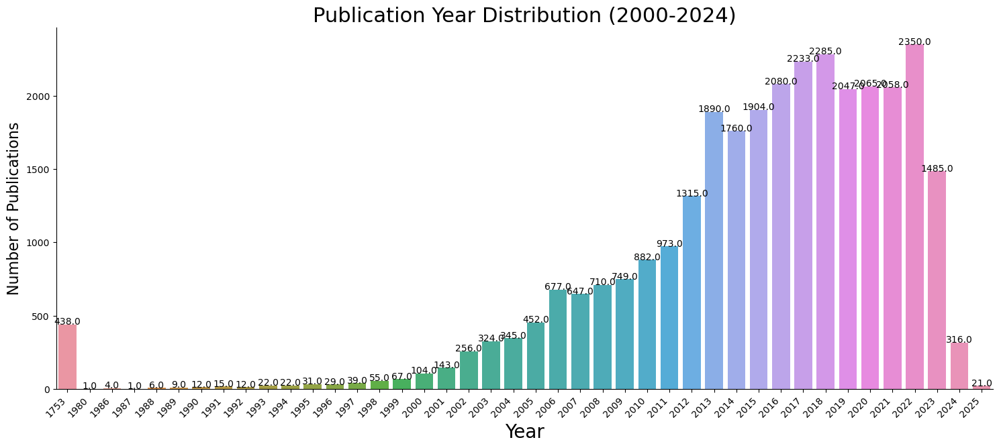

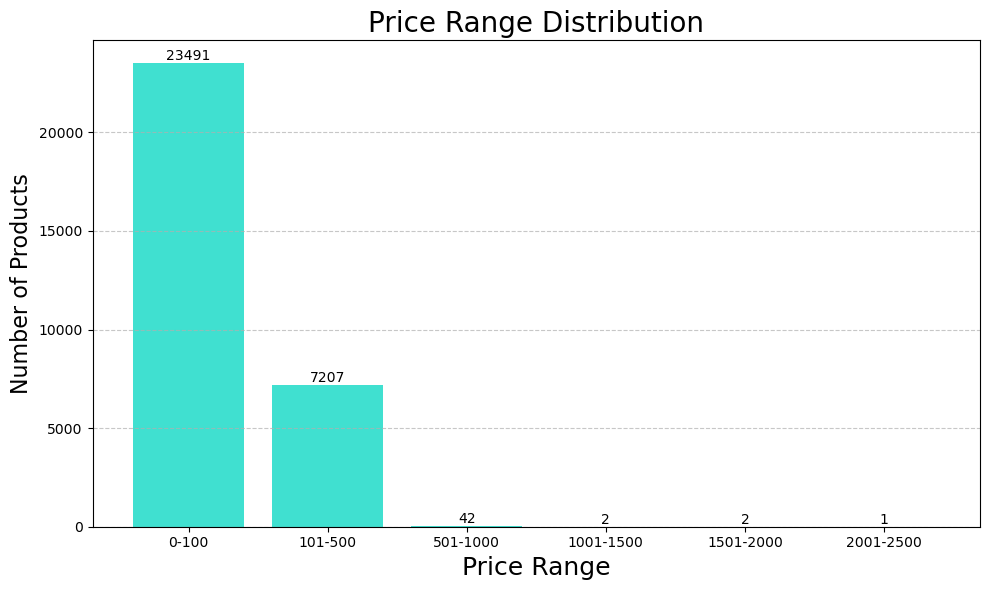

In [39]:
# Define the bins for price ranges
bins = [0, 100, 500, 1000, 1500, 2000, 2500]

# Create labels for the bins
labels = ['0-100', '101-500', '501-1000', '1001-1500', '1501-2000', '2001-2500']

# Create a new column with the bin labels based on the 'price' column
df['price_range'] = pd.cut(df['price'], bins = bins, labels = labels, right = False)

# Group by price range and count the occurrences
price_counts = df['price_range'].value_counts().sort_index()

# Plot
plt.figure(figsize = (10, 6))
bars = plt.bar(price_counts.index, price_counts.values, color = '#40E0D0')
plt.title('Price Range Distribution', fontdict = {'fontsize': 20})
plt.xlabel('Price Range', fontdict = {'fontsize': 18})
plt.ylabel('Number of Products', fontdict = {'fontsize': 16})
plt.xticks(rotation = 0)
plt.grid(axis = 'y', linestyle = '--', alpha = 0.7)

# Add count values on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, int(yval), va = 'bottom', ha = 'center')

plt.tight_layout()
plt.show()

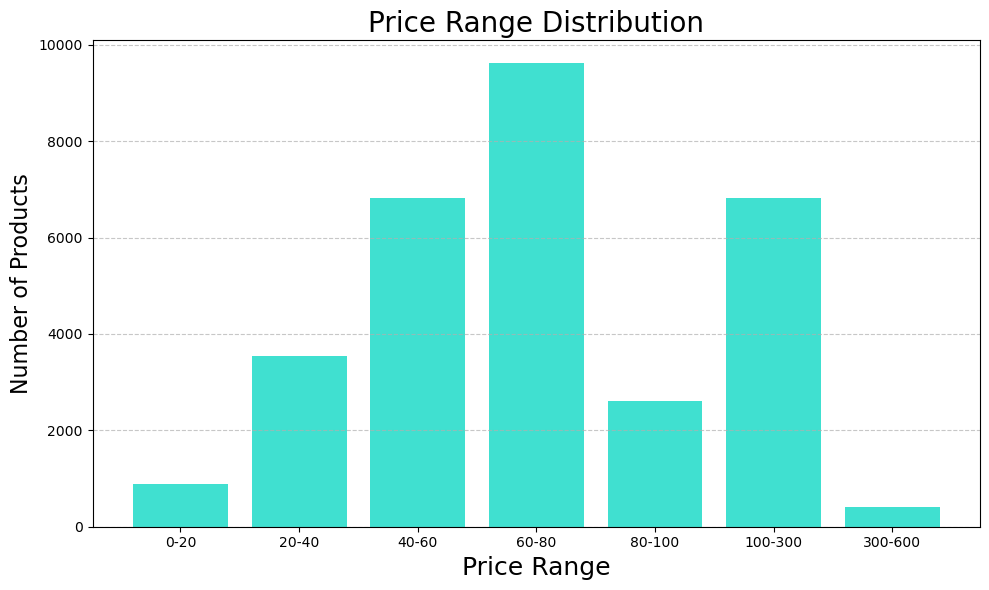

In [40]:
# Define the bins for price ranges
bins = [0, 20, 40, 60, 80, 100, 300, 600]

# Create labels for the bins
labels = ['0-20', '20-40', '40-60', '60-80', '80-100', '100-300', '300-600']

# Create a new column with the bin labels based on the 'price' column
df['price_range'] = pd.cut(df['price'], bins = bins, labels = labels, right = False)

# Group by price range and count the occurrences
price_counts = df['price_range'].value_counts().sort_index()

# Bar Plot
plt.figure(figsize = (10, 6))
plt.bar(price_counts.index, price_counts.values, color = '#40E0D0')
plt.title('Price Range Distribution', fontdict = {'fontsize': 20})
plt.xlabel('Price Range', fontdict = {'fontsize': 18})
plt.ylabel('Number of Products', fontdict = {'fontsize': 16})
plt.xticks(rotation = 0)
plt.grid(axis = 'y', linestyle = '--', alpha = 0.7)
plt.tight_layout()
plt.show()

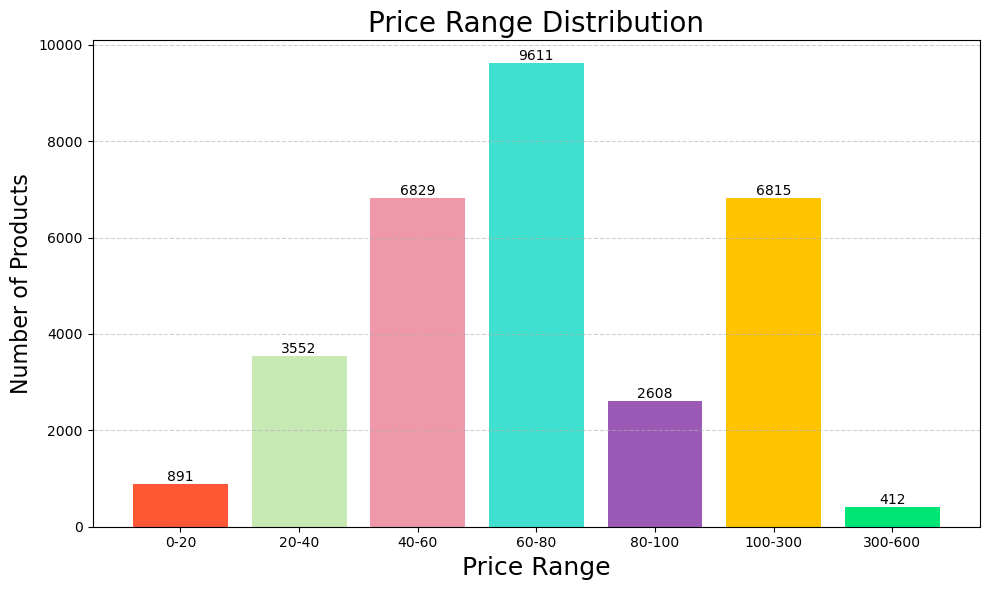

In [41]:
# Define colors for each price range
colors = ['#FF5733', "#c7e9b4", '#EE98AA', '#40E0D0', '#9B59B6', '#FFC300', '#00E676']
plt.figure(figsize = (10, 6))
bars = plt.bar(price_counts.index, price_counts.values, color = colors)
plt.title('Price Range Distribution', fontdict = {'fontsize': 20})
plt.xlabel('Price Range', fontdict = {'fontsize': 18})
plt.ylabel('Number of Products', fontdict = {'fontsize': 16})
plt.xticks(rotation = 0)
plt.grid(axis = 'y', linestyle = '--', alpha = 0.6)

# Add count values on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, int(yval), va = 'bottom', ha = 'center')

plt.tight_layout()
plt.show()

- We can notice that the majority of the books fall between the range of 60-80 $ which is quite a good price to buy 

Lets check the __'availability status'__ of books

In [42]:
df

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,...,width,height,processed_title,processed_description,hours,minutes,seconds,updated_price,edition,price_range
0,Learning Go,211190367,71.990000,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10,...,97,150,learning go,go rapidly become preferred language building ...,0,0,0,71.99,2,60-80
1,Tidy First?,211127822,42.990000,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17,...,97,150,tidy first,tidying messy software means breaking code mak...,0,0,0,42.99,NaN,40-60
2,"Hands-On Machine Learning with Scikit-Learn, K...",210681725,96.990000,Aurélien Géron,O'Reilly Media,2022,(3rd ed.),"Through a recent series of breakthroughs, deep...",True,2022-10-04,...,97,150,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,0,0,0,96.99,3,80-100
3,Designing Data-Intensive Applications,95729334,67.990000,Martin Kleppmann,O'Reilly Media,2017,NaN,Data is at the center of many challenges in sy...,True,2017-03-16,...,97,150,designing data intensive applications,data center many challenges system design toda...,0,0,0,67.99,NaN,60-80
4,Exam Ref MS-102 Microsoft 365 Administrator,210964419,53.862731,Orin Thomas,Pearson Education,2023,NaN,Prepare for Microsoft Exam MS-102 and help dem...,True,2023-10-18,...,97,150,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,0,0,0,53.86,NaN,40-60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39977,Finite-State Methods and Natural Language Proc...,2476527,72.641169,Anssi Yli-Jyrä,Springer Berlin Heidelberg,2006,NaN,This book constitutes the thoroughly refereed ...,True,2006-12-12,...,97,150,finite state methods and natural language proc...,book constitutes thoroughly refereed post proc...,0,0,0,72.64,NaN,60-80
39978,Argumentation in Multi-Agent Systems,2476617,72.641169,Simon D. Parsons,Springer Berlin Heidelberg,2006,NaN,NaN,True,2006-07-25,...,97,150,argumentation in multi agent systems,nan,0,0,0,72.64,NaN,60-80
39979,PRICAI 2006: Trends in Artificial Intelligence,2476718,232.483709,Quiang Yang,Springer Berlin Heidelberg,2008,NaN,This book constitutes the refereed proceedings...,True,2008-02-20,...,97,150,pricai trends in artificial intelligence,book constitutes refereed proceedings th pacif...,0,0,0,232.48,NaN,100-300
39988,"Knowledge Science, Engineering and Management",2476736,130.765729,Jérôme Lang,Springer Berlin Heidelberg,2006,NaN,Here are the refereed proceedings of the First...,True,2006-07-25,...,97,150,knowledge science engineering and management,refereed proceedings first international confe...,0,0,0,130.77,NaN,100-300


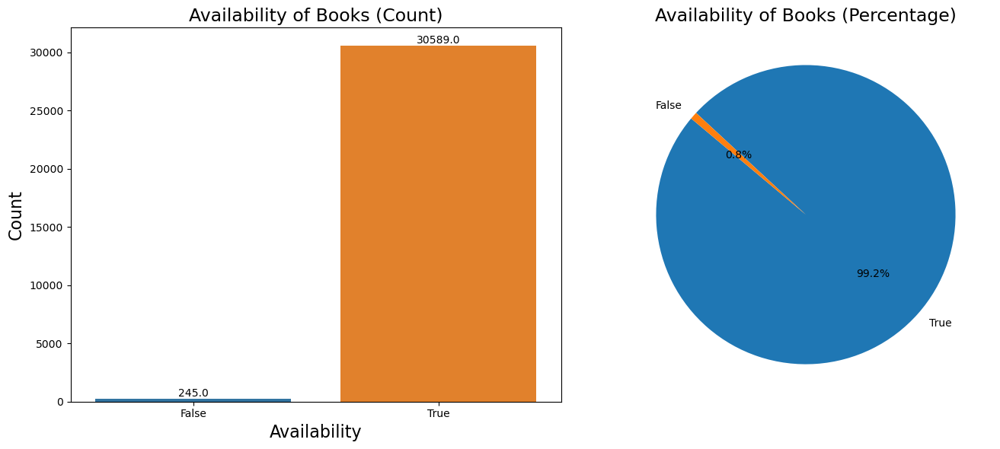

In [43]:
# Count the occurrences of True and False in 'available' column
availability_counts = df['availabe'].value_counts()

# Create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (14, 6))

# Plot bar graph
sns.barplot(x = availability_counts.index, y = availability_counts.values, ax = ax1)
ax1.set_title('Availability of Books (Count)', fontdict = {'fontsize': 17})
ax1.set_xlabel('Availability', fontdict = {'fontsize': 16})
ax1.set_ylabel('Count', fontdict = {'fontsize': 16})

# Display count on top of each bar
for p in ax1.patches:
    ax1.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 5), textcoords='offset points')

# Plot pie chart
ax2.pie(availability_counts.values, labels = availability_counts.index, autopct = '%1.1f%%', startangle = 140)
ax2.set_title('Availability of Books (Percentage)', fontdict = {'fontsize': 17})

plt.tight_layout()
plt.show()

From our pie chart, we can see that almost all books are available as __99.2 %__ of books are __in stock__, whereas only __0.8 %__ are __not available__.

Let's do some analysis on our __Top 10 authors as per their number of books published__.

In [44]:
len(list(df['author'].unique()))

20385

In [45]:
len(list(df['publisher'].unique()))

194

In [46]:
df['publisher'].value_counts()

Springer International Publishing    8432
Packt Publishing                     3928
Apress                               3061
CRC Press                            2719
Springer Berlin Heidelberg           2350
                                     ... 
TeeBooks                                1
Stonesong Digital LLC                   1
Tsunami Productions                     1
NYU Press                               1
University of Chicago Press             1
Name: publisher, Length: 194, dtype: int64

In [47]:
df['author'].value_counts()

Guy Hart-Davis           44
Paul McFedries           43
Michael R. Miller        43
Matthew MacDonald        41
Osvaldo Gervasi          38
                         ..
Gregory Kipper            1
Benjamin A. Lieberman     1
Reynolds M. Salerno       1
Jonathan S. Held          1
Jérôme Lang               1
Name: author, Length: 20384, dtype: int64

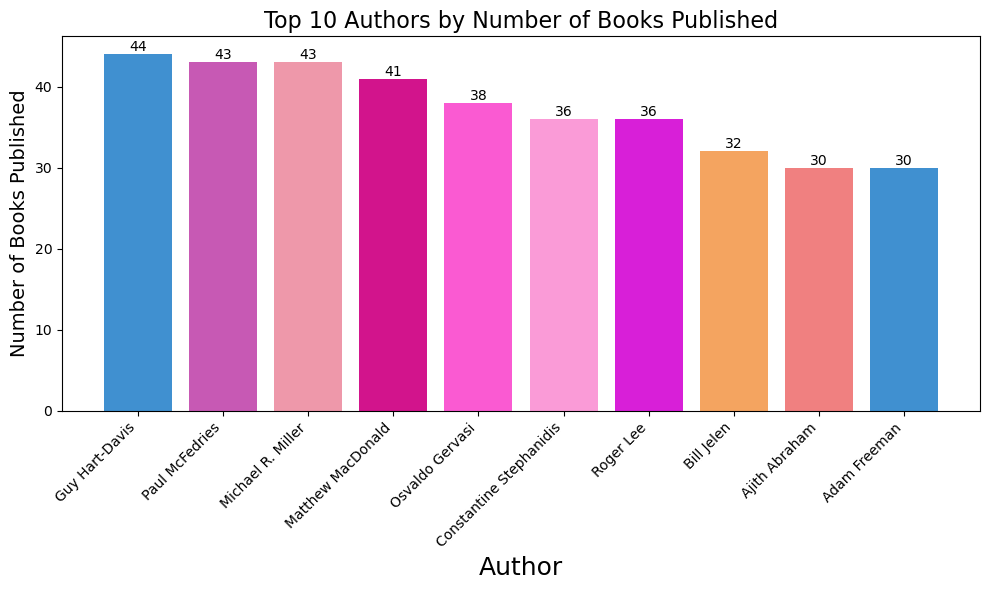

In [48]:
# Count the occurrences of each author
author_counts = df['author'].value_counts().head(10)

colors = ['#4090D0','#C759B4', '#EE98AA', '#D2148C', '#FA5AD2','#FA9BD7', '#D81FD8','#F4A460','#F08080']

# Plot
plt.figure(figsize = (10, 6))
bars = plt.bar(author_counts.index, author_counts.values, color = colors)
plt.title('Top 10 Authors by Number of Books Published', fontdict = {'fontsize': 16})
plt.xlabel('Author', fontdict = {'fontsize': 18})
plt.ylabel('Number of Books Published', fontdict = {'fontsize': 14})
plt.xticks(rotation=45, ha='right')

# Add count values on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()


Now, Lets generate a bar plot showing the __distribution of editions__ based on the __counts.__

In [49]:
df['edition'].unique()

array(['2', nan, '3', '8', '5', '7', '6', '4', '9', '11', '12', '10',
       '22', '14', '13', '19', '18', '57', '15', '31', '16', '21'],
      dtype=object)

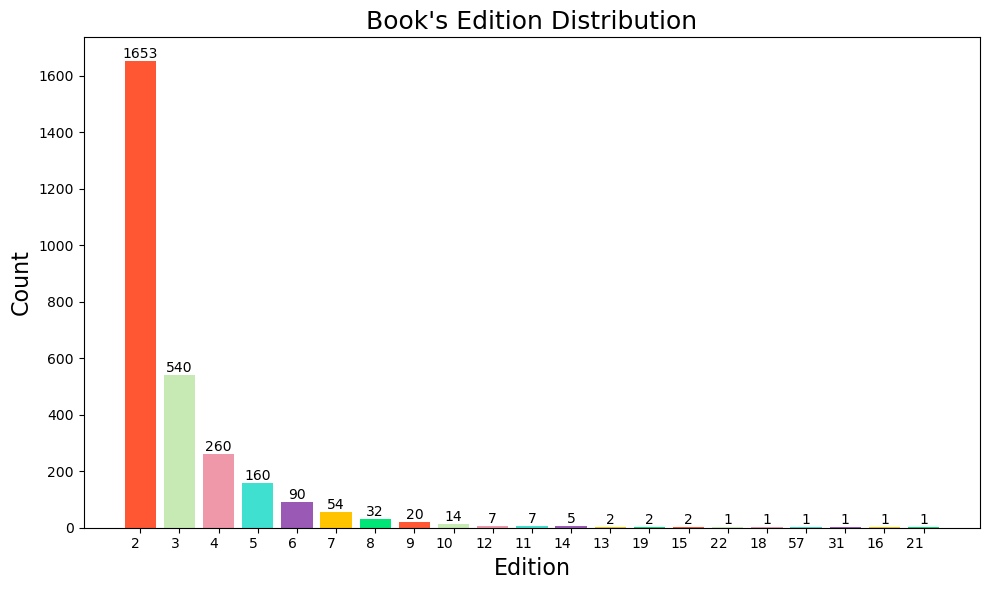

In [50]:
# Count the occurrences of each edition
edition_counts = df['edition'].value_counts()

# Define colors for each price range
colors = ['#FF5733', "#c7e9b4", '#EE98AA', '#40E0D0', '#9B59B6', '#FFC300', '#00E676']

# Plot
plt.figure(figsize=(10, 6))
bars = plt.bar(edition_counts.index, edition_counts.values, color = colors)
plt.title("Book's Edition Distribution", fontdict = {'fontsize': 18})
plt.xlabel('Edition', fontdict = {'fontsize': 16})
plt.ylabel('Count', fontdict = {'fontsize': 16})
plt.xticks(rotation = 0, ha = 'right')

# Add count values on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, int(yval), va = 'bottom', ha = 'center')

plt.tight_layout()
plt.show()

Lets visualize the __top eight mostly used words__ in __'description' column__

In [51]:
#Creating a counter to check most frequent words
from collections import Counter
c = Counter()
for txt in df.processed_description.values:
    for word in txt.split():
        c[word] += 1
c.most_common(8)

[('book', 13426),
 ('conference', 6090),
 ('held', 5634),
 ('international', 5477),
 ('papers', 5104),
 ('proceedings', 5007),
 ('constitutes', 4834),
 ('data', 4648)]

In [52]:
list(c)

['go',
 'rapidly',
 'become',
 'preferred',
 'language',
 'building',
 'web',
 'services',
 'plenty',
 'tutorials',
 'available',
 'teach',
 'syntax',
 'developers',
 'experience',
 'programming',
 'languages',
 'enough',
 'idioms',
 'end',
 'recreating',
 'patterns',
 'make',
 'sense',
 'context',
 'practical',
 'tidying',
 'messy',
 'software',
 'means',
 'breaking',
 'code',
 'readable',
 'using',
 'guard',
 'clauses',
 'helping',
 'functions',
 'understandable',
 'guide',
 'kent',
 'beck',
 'creator',
 'extreme',
 'pioneer',
 'suggests',
 'might',
 'apply',
 'tidyings',
 'recent',
 'series',
 'breakthroughs',
 'deep',
 'learning',
 'boosted',
 'entire',
 'field',
 'machine',
 'even',
 'programmers',
 'know',
 'close',
 'nothing',
 'technology',
 'use',
 'simple',
 'efficient',
 'tools',
 'implement',
 'programs',
 'capable',
 'data',
 'bestselling',
 'book',
 'uses',
 'concrete',
 'examples',
 'minimal',
 'theory',
 'production',
 'ready',
 'center',
 'many',
 'challenges',
 'syste

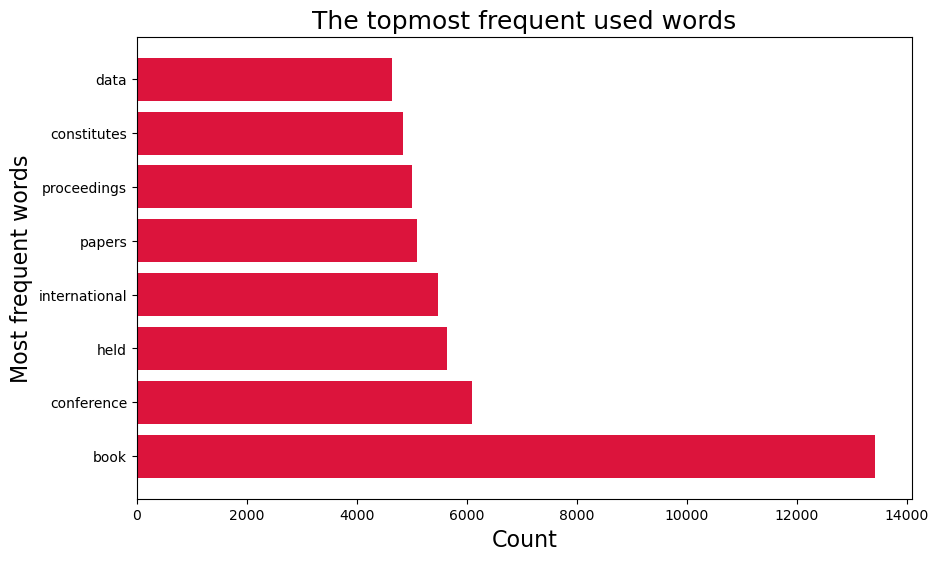

In [53]:
y = [count for x, count in c.most_common(8)]
x = [x for x, count in c.most_common(8)]
plt.figure(figsize=(10, 6))
plt.barh(x, y, color = 'crimson')
plt.title("The topmost frequent used words", fontdict = {'fontsize': 18})
plt.xlabel('Count', fontdict = {'fontsize': 16})
plt.ylabel("Most frequent words", fontdict = {'fontsize': 16})
plt.show()

__Function to create a Word Cloud__

The most frequent words in out 'processed_title' feature

In [54]:
t = ' '.join(word for word in df['processed_title'].astype(str)) 

In [55]:
def word_cloud(text):
    word_cloud = WordCloud(width = 1600, height = 800, random_state = 21,
                           max_font_size = 110, collocations=False,
                           min_font_size = 18).generate_from_text(t)
    plt.figure(figsize = (15, 10))
    plt.imshow(word_cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

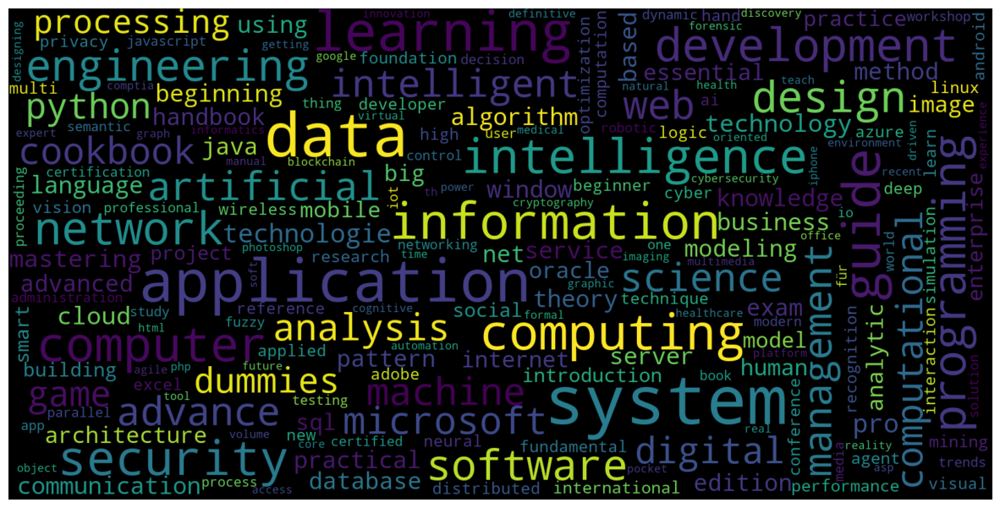

In [56]:
word_cloud(word_cloud)

# Step 4: Pandas Profiling

Lets use the __ydata-profiling__ to generate the detailed reports, complete with statistics and visualizations. 
- provides comprehensive insights, enhances data quality

In [57]:
#pd_profile = ProfileReport(df, title = "Profiling Report")

In [58]:
import ydata_profiling as pp

In [59]:
report=pp.ProfileReport(df)

In [60]:
report.to_file('first_version.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [61]:
report

In [62]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30834 entries, 0 to 39989
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   Title                  30834 non-null  object        
 1   id                     30834 non-null  int64         
 2   price                  30745 non-null  float64       
 3   author                 30828 non-null  object        
 4   publisher              30834 non-null  object        
 5   pub_year               30834 non-null  int64         
 6   edition_num            2854 non-null   object        
 7   description            26597 non-null  object        
 8   availabe               30834 non-null  bool          
 9   sale_date              30834 non-null  datetime64[ns]
 10  short_pub              30834 non-null  object        
 11  num_of_author          30834 non-null  int64         
 12  width                  30834 non-null  int64         
 13  h

In [63]:
pd.options.display.max_columns = None

In [64]:
df.head()[:20]

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title,processed_description,hours,minutes,seconds,updated_price,edition,price_range
0,Learning Go,211190367,71.990000,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10,Jan 2024,1,97,150,learning go,go rapidly become preferred language building ...,0,0,0,71.99,2,60-80
1,Tidy First?,211127822,42.990000,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17,Oct 2023,1,97,150,tidy first,tidying messy software means breaking code mak...,0,0,0,42.99,NaN,40-60
2,"Hands-On Machine Learning with Scikit-Learn, K...",210681725,96.990000,Aurélien Géron,O'Reilly Media,2022,(3rd ed.),"Through a recent series of breakthroughs, deep...",True,2022-10-04,Oct 2022,1,97,150,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,0,0,0,96.99,3,80-100
3,Designing Data-Intensive Applications,95729334,67.990000,Martin Kleppmann,O'Reilly Media,2017,NaN,Data is at the center of many challenges in sy...,True,2017-03-16,Mar 2017,1,97,150,designing data intensive applications,data center many challenges system design toda...,0,0,0,67.99,NaN,60-80
4,Exam Ref MS-102 Microsoft 365 Administrator,210964419,53.862731,Orin Thomas,Pearson Education,2023,NaN,Prepare for Microsoft Exam MS-102 and help dem...,True,2023-10-18,Oct 2023,1,97,150,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,0,0,0,53.86,NaN,40-60


In [65]:
# saving the profile report to 'html' format
#pd_profile.to_file("data_output.html")

# Step 5: Encoding 

In [66]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30834 entries, 0 to 39989
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   Title                  30834 non-null  object        
 1   id                     30834 non-null  int64         
 2   price                  30745 non-null  float64       
 3   author                 30828 non-null  object        
 4   publisher              30834 non-null  object        
 5   pub_year               30834 non-null  int64         
 6   edition_num            2854 non-null   object        
 7   description            26597 non-null  object        
 8   availabe               30834 non-null  bool          
 9   sale_date              30834 non-null  datetime64[ns]
 10  short_pub              30834 non-null  object        
 11  num_of_author          30834 non-null  int64         
 12  width                  30834 non-null  int64         
 13  h

In [67]:
df.head()

,Title,id,price,author,publisher,pub_year,edition_num,description,availabe,sale_date,short_pub,num_of_author,width,height,processed_title,processed_description,hours,minutes,seconds,updated_price,edition,price_range
0,Learning Go,211190367,71.990000,Jon Bodner,O'Reilly Media,2024,(2nd ed.),Go has rapidly become the preferred language f...,True,2024-01-10,Jan 2024,1,97,150,learning go,go rapidly become preferred language building ...,0,0,0,71.99,2,60-80
1,Tidy First?,211127822,42.990000,Kent Beck,O'Reilly Media,2023,NaN,Tidying up messy software is a must. And that ...,True,2023-10-17,Oct 2023,1,97,150,tidy first,tidying messy software means breaking code mak...,0,0,0,42.99,NaN,40-60
2,"Hands-On Machine Learning with Scikit-Learn, K...",210681725,96.990000,Aurélien Géron,O'Reilly Media,2022,(3rd ed.),"Through a recent series of breakthroughs, deep...",True,2022-10-04,Oct 2022,1,97,150,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,0,0,0,96.99,3,80-100
3,Designing Data-Intensive Applications,95729334,67.990000,Martin Kleppmann,O'Reilly Media,2017,NaN,Data is at the center of many challenges in sy...,True,2017-03-16,Mar 2017,1,97,150,designing data intensive applications,data center many challenges system design toda...,0,0,0,67.99,NaN,60-80
4,Exam Ref MS-102 Microsoft 365 Administrator,210964419,53.862731,Orin Thomas,Pearson Education,2023,NaN,Prepare for Microsoft Exam MS-102 and help dem...,True,2023-10-18,Oct 2023,1,97,150,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,0,0,0,53.86,NaN,40-60


In [68]:
df.columns.to_list()

['Title',
 'id',
 'price',
 'author',
 'publisher',
 'pub_year',
 'edition_num',
 'description',
 'availabe',
 'sale_date',
 'short_pub',
 'num_of_author',
 'width',
 'height',
 'processed_title',
 'processed_description',
 'hours',
 'minutes',
 'seconds',
 'updated_price',
 'edition',
 'price_range']

Creating a segment of dataset focusing more on the encoding part of the process

In [69]:
df_5=df[[
 'publisher',
 'pub_year',
 'sale_date',
 'num_of_author',
 'processed_title',
 'processed_description',
 'updated_price',
 'edition',
 'availabe']]

In [70]:
df_5

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availabe
0,O'Reilly Media,2024,2024-01-10,1,learning go,go rapidly become preferred language building ...,71.99,2,True
1,O'Reilly Media,2023,2023-10-17,1,tidy first,tidying messy software means breaking code mak...,42.99,NaN,True
2,O'Reilly Media,2022,2022-10-04,1,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,96.99,3,True
3,O'Reilly Media,2017,2017-03-16,1,designing data intensive applications,data center many challenges system design toda...,67.99,NaN,True
4,Pearson Education,2023,2023-10-18,1,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,53.86,NaN,True
...,...,...,...,...,...,...,...,...,...
39977,Springer Berlin Heidelberg,2006,2006-12-12,3,finite state methods and natural language proc...,book constitutes thoroughly refereed post proc...,72.64,NaN,True
39978,Springer Berlin Heidelberg,2006,2006-07-25,4,argumentation in multi agent systems,nan,72.64,NaN,True
39979,Springer Berlin Heidelberg,2008,2008-02-20,2,pricai trends in artificial intelligence,book constitutes refereed proceedings th pacif...,232.48,NaN,True
39988,Springer Berlin Heidelberg,2006,2006-07-25,3,knowledge science engineering and management,refereed proceedings first international confe...,130.77,NaN,True


In [71]:
#applying the nunqiue and unique value method on the current df

In [72]:
columns=df_5.columns.to_list()

In [73]:
for column in columns:
    print("{} has {} unique values".format(column,df_5[column].nunique()))
    
#use this for report

publisher has 194 unique values
pub_year has 42 unique values
sale_date has 6477 unique values
num_of_author has 25 unique values
processed_title has 24828 unique values
processed_description has 25521 unique values
updated_price has 1274 unique values
edition has 21 unique values
availabe has 2 unique values


In [74]:
print(df_5['availabe'].value_counts(dropna=False)) #use it for validation

True     30589
False      245
Name: availabe, dtype: int64


In [75]:
print(df_5['availabe'].value_counts(dropna=False,normalize=True)*100) #repeating the code for percentage to confirm the distribution

True     99.205423
False     0.794577
Name: availabe, dtype: float64


In [76]:
df_5.nunique(dropna=False)

publisher                  194
pub_year                    42
sale_date                 6477
num_of_author               25
processed_title          24828
processed_description    25521
updated_price             1275
edition                     22
availabe                     2
dtype: int64

In [77]:
df.nunique(dropna=True, axis='columns') #interesting method to finding unqiue values in the rows --> not used for this scope

0        18
1        16
2        18
3        16
4        17
         ..
39977    18
39978    17
39979    18
39988    18
39989    18
Length: 30834, dtype: int64

In [78]:
#using mode to find the most freq(repeating) value in each column in price and year

to_get_value_bin= df_5[['updated_price','pub_year']].apply(lambda x: x.mode().tolist())
print(to_get_value_bin)

   updated_price  pub_year
0          72.64      2022


In [79]:
df_5[['updated_price','pub_year']].quantile(np.arange(.01,.9,.1))

,updated_price,pub_year
0.01,8.53,1753.0
0.11,35.99,2007.0
0.21,47.52,2011.0
0.31,54.30,2013.0
0.41,64.64,2015.0
0.51,72.64,2016.0
0.61,72.64,2018.0
0.71,84.99,2019.0
0.81,126.99,2021.0


In [80]:
"""from the observation of unqiue values present in the current df_5, publisher has 194 values --> this distinct will be difficult 
for encoding like one-hot as the dimensionality issue araises and creates zero in various columns (sparse matrix)
"""

'from the observation of unqiue values present in the current df_5, publisher has 194 values --> this distinct will be difficult \nfor encoding like one-hot as the dimensionality issue araises and creates zero in various columns (sparse matrix)\n'

In [81]:
# available columns can be mapped or modified to binary column without losing the orginality of the data

In [82]:
#encoding categorical values 

df_5=pd.get_dummies(df_5, columns=['availabe'], prefix=['availability'],drop_first=True)
df_5.rename(columns={'availability_True':'availability_encoded'},inplace=True)


In [83]:
# other possiblity we are looking at here is encoding the num_of_author --> which is potentially in the numeric format and we would like to continute with same


In [84]:
#edition is very straight forward

In [85]:
#experiment 1 in encoding of price and year using discretization--> encoding (easy to process compared to 200+ distinct varients)

In [86]:
price_bins = pd.cut(df_5.updated_price,bins=10 ,right=True)

In [87]:
price_bins
#( --> not included value
#] included value

0        (-2.353, 235.337]
1        (-2.353, 235.337]
2        (-2.353, 235.337]
3        (-2.353, 235.337]
4        (-2.353, 235.337]
               ...        
39977    (-2.353, 235.337]
39978    (-2.353, 235.337]
39979    (-2.353, 235.337]
39988    (-2.353, 235.337]
39989    (-2.353, 235.337]
Name: updated_price, Length: 30834, dtype: category
Categories (10, interval[float64, right]): [(-2.353, 235.337] < (235.337, 470.674] < (470.674, 706.011] < (706.011, 941.348] ... (1412.022, 1647.359] < (1647.359, 1882.696] < (1882.696, 2118.033] < (2118.033, 2353.37]]

In [88]:
price_bins.cat.codes

0        0
1        0
2        0
3        0
4        0
        ..
39977    0
39978    0
39979    0
39988    0
39989    0
Length: 30834, dtype: int8

In [89]:
price_bins.cat.codes.value_counts()

 0    29574
 1     1105
-1       89
 2       48
 3       13
 6        1
 5        1
 9        1
 7        1
 4        1
dtype: int64

In [90]:
#converting numeric data into categorical data
#divides the data into bins based on values given  and we used the qcut--> qunatile based binning with same number of bins 
price_bin_number,bin_range = pd.qcut(df_5['updated_price'], q=8, labels=False, duplicates='drop',retbins=True)

print(price_bin_number)

0        3.0
1        1.0
2        6.0
3        3.0
4        2.0
        ... 
39977    3.0
39978    3.0
39979    7.0
39988    6.0
39989    3.0
Name: updated_price, Length: 30834, dtype: float64


In [91]:
bin_range

array([   0.  ,   37.99,   49.99,   61.41,   72.64,   72.9 ,   94.44,
        134.69, 2353.37])

In [92]:
year_bin_number,y_bin_range = pd.qcut(df_5['pub_year'], q=12, labels=False, duplicates='drop',retbins=True)

print(year_bin_number)

0        11
1        11
2        10
3         6
4        11
         ..
39977     0
39978     0
39979     1
39988     0
39989     0
Name: pub_year, Length: 30834, dtype: int64


In [93]:
y_bin_range

array([1753., 2006., 2009., 2012., 2014., 2015., 2016., 2017., 2019.,
       2020., 2021., 2022., 2025.])

In [94]:
df_5['encoded_price']=price_bin_number
# df_5['price_bins']=bin_range
df_5['encoded_year']=year_bin_number
# df_5['year_bins']=year_bin_number

In [95]:
#description processing pipeline --> key words and TF-IDF
def key_words(text):
    """
    arg: text data

    function: applying lemmatization, NER and other tokenization technique

    return: text tokens
    """
    tokens = word_tokenize(text.lower()) #it lowered but making sure one more time    
    lemma=WordNetLemmatizer()
    key_1 = [lemma.lemmatize(token) for token in tokens]
    
    #get most common words and also key words
    word_counts=Counter(key_1)
    freq_words=word_counts.most_common()
    print(freq_words)
    common_=[word for word,cont in freq_words]
    key_words=key_1
    return key_words,common_

df_5['key_words'],df_5['common_word'] = zip(*df_5['processed_description'].apply(key_words))
df_5['length_title_description']=df_5['processed_title'].str.len()+df_5['processed_description'].str.len()
        

[('go', 4), ('language', 2), ('tutorial', 2), ('teach', 2), ('developer', 2), ('rapidly', 1), ('become', 1), ('preferred', 1), ('building', 1), ('web', 1), ('service', 1), ('plenty', 1), ('available', 1), ('syntax', 1), ('experience', 1), ('programming', 1), ('enough', 1), ('idiom', 1), ('end', 1), ('recreating', 1), ('pattern', 1), ('make', 1), ('sense', 1), ('context', 1), ('practical', 1)]
[('software', 2), ('code', 2), ('make', 2), ('tidying', 1), ('messy', 1), ('mean', 1), ('breaking', 1), ('readable', 1), ('using', 1), ('guard', 1), ('clause', 1), ('helping', 1), ('function', 1), ('understandable', 1), ('practical', 1), ('guide', 1), ('kent', 1), ('beck', 1), ('creator', 1), ('extreme', 1), ('programming', 1), ('pioneer', 1), ('pattern', 1), ('suggests', 1), ('might', 1), ('apply', 1), ('tidyings', 1)]
[('learning', 3), ('recent', 1), ('series', 1), ('breakthrough', 1), ('deep', 1), ('boosted', 1), ('entire', 1), ('field', 1), ('machine', 1), ('even', 1), ('programmer', 1), ('kno

In [96]:
df_5.head()

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description
0,O'Reilly Media,2024,2024-01-10,1,learning go,go rapidly become preferred language building ...,71.99,2,1,3.0,11,"[go, rapidly, become, preferred, language, bui...","[go, language, tutorial, teach, developer, rap...",256
1,O'Reilly Media,2023,2023-10-17,1,tidy first,tidying messy software means breaking code mak...,42.99,NaN,1,1.0,11,"[tidying, messy, software, mean, breaking, cod...","[software, code, make, tidying, messy, mean, b...",240
2,O'Reilly Media,2022,2022-10-04,1,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,96.99,3,1,6.0,10,"[recent, series, breakthrough, deep, learning,...","[learning, recent, series, breakthrough, deep,...",330
3,O'Reilly Media,2017,2017-03-16,1,designing data intensive applications,data center many challenges system design toda...,67.99,NaN,1,3.0,6,"[data, center, many, challenge, system, design...","[data, center, many, challenge, system, design...",301
4,Pearson Education,2023,2023-10-18,1,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,53.86,NaN,1,2.0,11,"[prepare, microsoft, exam, m, help, demonstrat...","[microsoft, prepare, exam, m, help, demonstrat...",220


In [97]:
## get the total days from the year - keep a reference date

# Step 6: Outliers 

In [99]:
#finding outliers present in the data using various plots and IQR method

In [104]:
def get_numeric_column_list(dataframe):
    col_list=dataframe.select_dtypes(include=['int64','float64']).columns.to_list()
    return col_list

In [105]:
df_5_num=get_numeric_column_list(df_5)

In [106]:
df_5_num

['pub_year',
 'num_of_author',
 'updated_price',
 'encoded_price',
 'encoded_year',
 'length_title_description']

In [107]:
def get_cat_column_list(dataframe):
    col_list=dataframe.select_dtypes(include=['category','object']).columns.to_list()
    return col_list

In [108]:
df_5_cat=get_cat_column_list(df_5)

In [109]:
df_5_cat

['publisher',
 'processed_title',
 'processed_description',
 'edition',
 'key_words',
 'common_word']

In [113]:
#skewness and kurtosis

def get_skew(dataframe):
    return(dataframe[df_5_num].skew())

def get_kurtosis(dataframe):
    return(dataframe[df_5_num].kurtosis())

In [115]:
## need to write about the method and why we did it

In [114]:

print(get_skew(df_5))
print("="*50+'\n')
print(get_kurtosis(df_5))

pub_year                   -7.808904
num_of_author               3.817480
updated_price               4.781890
encoded_price               0.160137
encoded_year                0.074889
length_title_description   -0.946613
dtype: float64

pub_year                    61.063401
num_of_author               53.025266
updated_price               75.020890
encoded_price               -1.222470
encoded_year                -1.176155
length_title_description     0.425935
dtype: float64


In [117]:
#IQR method
#first simple method of understanding the data distributuin using quantile


df_5.quantile(np.arange(.1,1.1,.1),axis=0).T #plotting for all the 10percentile of the values

,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0
pub_year,2007.00,2011.00,2013.00,2015.00,2016.00,2018.00,2019.0,2021.00,2022.00,2025.00
num_of_author,1.00,1.00,1.00,1.00,2.00,2.00,3.0,3.00,4.00,59.00
updated_price,35.15,45.99,53.86,63.82,72.64,72.64,83.3,118.46,173.95,2353.37
availability_encoded,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00
encoded_price,0.00,1.00,2.00,3.00,3.00,3.00,5.0,6.00,7.00,7.00
encoded_year,1.00,2.00,3.00,4.00,5.00,7.00,7.0,9.00,10.00,11.00
length_title_description,43.00,176.00,197.00,209.00,220.00,231.00,245.0,266.00,294.00,489.00


In [118]:
#write clear understanding of outliers using this table--> your interpretation

In [127]:
#IQR method

out={}
for col in df_5_num:
    q1=df_5[col].quantile(.25).round(2)
    q2=df_5[col].median()
    q3=df_5[col].quantile(.75).round(2)
    iqr=(q3-q1).round(2)
    lw=(q1-(1.5*iqr)).round(2)
    uw=(q1+(1.5*iqr)).round(2)
    
    out[col]={"IQR":iqr,"Lower_whisker":lw,"quater1":q1,"mid":q2,"quater3":q3,"upper_whisker":uw}

In [134]:
for i,j in out.items():
    print(i,"\n")
    for ii,jj in value.items():
        print("{} : {}".format(ii,jj))
    print()
    print("="*50)

pub_year 

IQR : 66.0
Lower_whisker : 90.0
quater1 : 189.0
mid : 220.0
quater3 : 255.0
upper_whisker : 288.0

num_of_author 

IQR : 66.0
Lower_whisker : 90.0
quater1 : 189.0
mid : 220.0
quater3 : 255.0
upper_whisker : 288.0

updated_price 

IQR : 66.0
Lower_whisker : 90.0
quater1 : 189.0
mid : 220.0
quater3 : 255.0
upper_whisker : 288.0

encoded_price 

IQR : 66.0
Lower_whisker : 90.0
quater1 : 189.0
mid : 220.0
quater3 : 255.0
upper_whisker : 288.0

encoded_year 

IQR : 66.0
Lower_whisker : 90.0
quater1 : 189.0
mid : 220.0
quater3 : 255.0
upper_whisker : 288.0

length_title_description 

IQR : 66.0
Lower_whisker : 90.0
quater1 : 189.0
mid : 220.0
quater3 : 255.0
upper_whisker : 288.0



In [129]:
#calculated the IQR and varified the values of quantile using the formula

In [135]:
#plotting

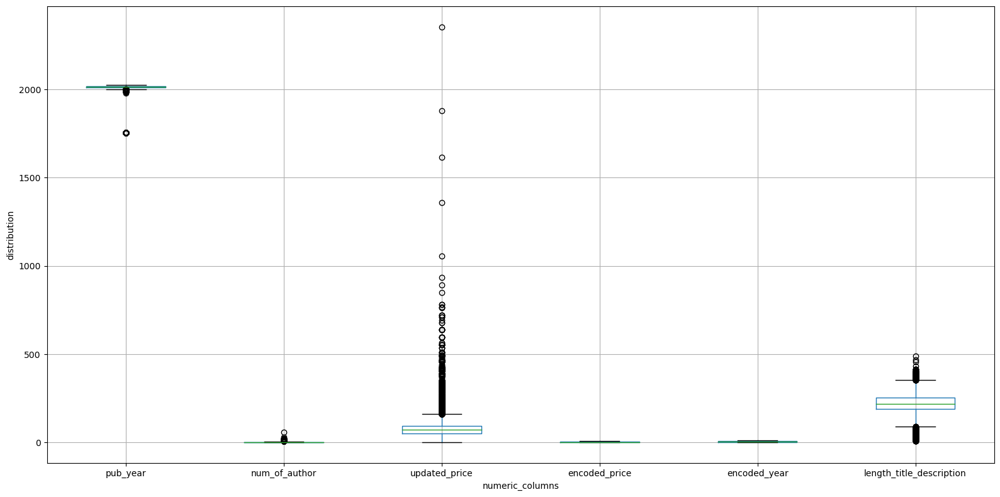

In [143]:
plt.figure(figsize=(16,8))

df_5[df_5_num].boxplot()
plt.xlabel("numeric_columns")
plt.ylabel("distribution")
plt.tight_layout() 
plt.show()

In [162]:
#getting you the box plot

def box_plot(dataframe):
    for col in df_5_num:
        plt.figure(figsize=(6, 8))
        plt.boxplot(dataframe[col].dropna())  
        plt.xlabel('{}'.format(col))
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()


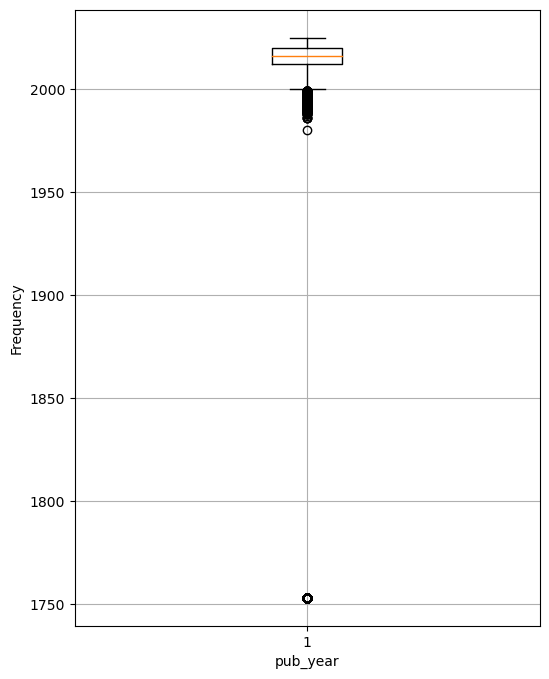

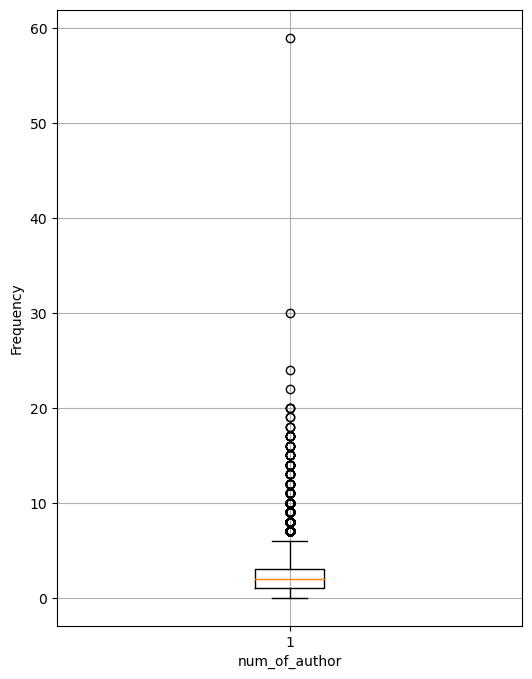

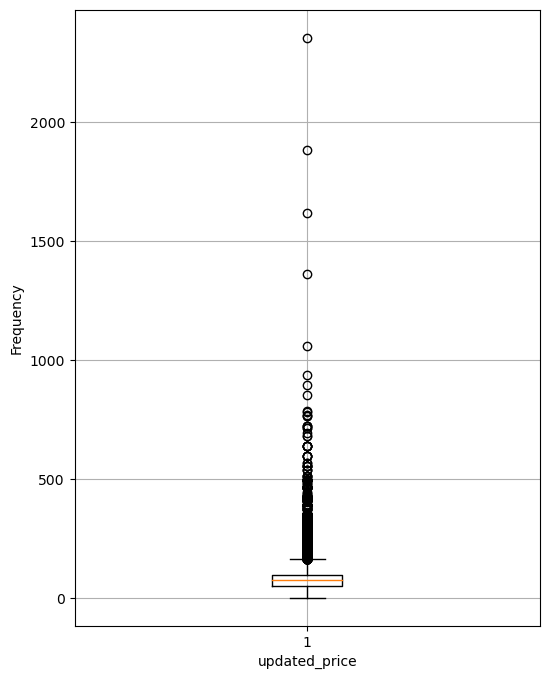

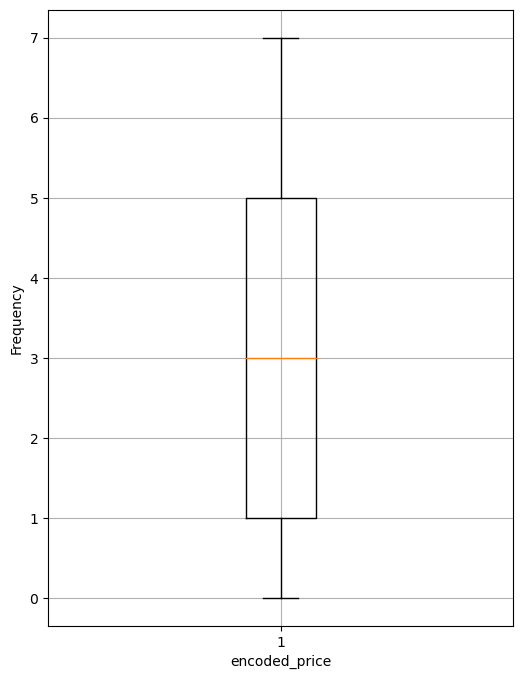

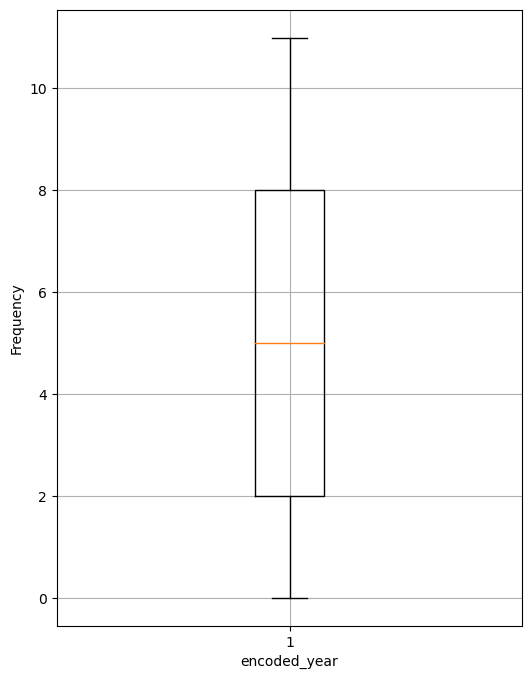

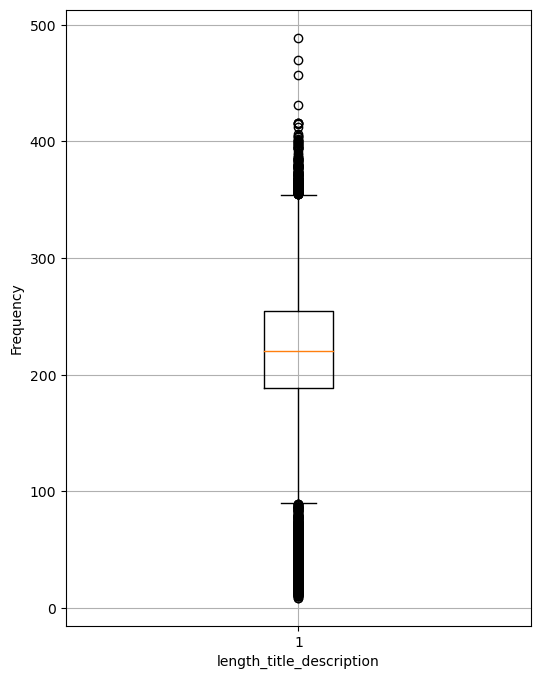

In [163]:
box_plot(df_5)

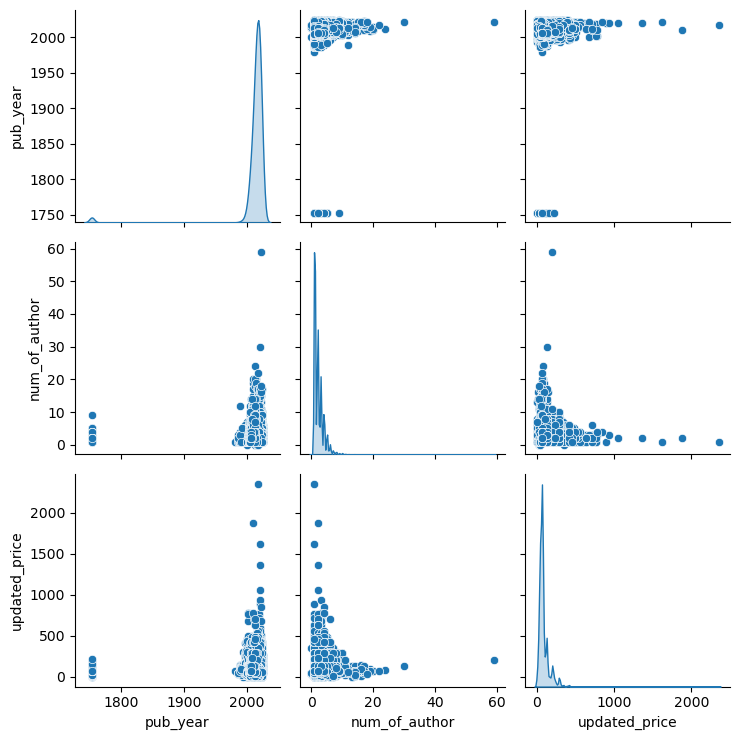

In [179]:
sns.pairplot(df_5[df_5_num[:3]],diag_kind='kde')
plt.tight_layout()
plt.show()

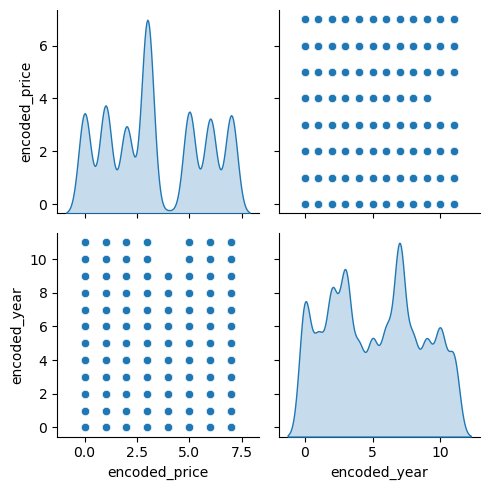

In [173]:
sns.pairplot(df_5[df_5_num[3:5]],diag_kind='kde')
plt.tight_layout()
plt.show()

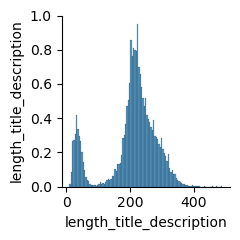

In [172]:
sns.pairplot(df_5[df_5_num[5:]])
plt.tight_layout()
plt.show()

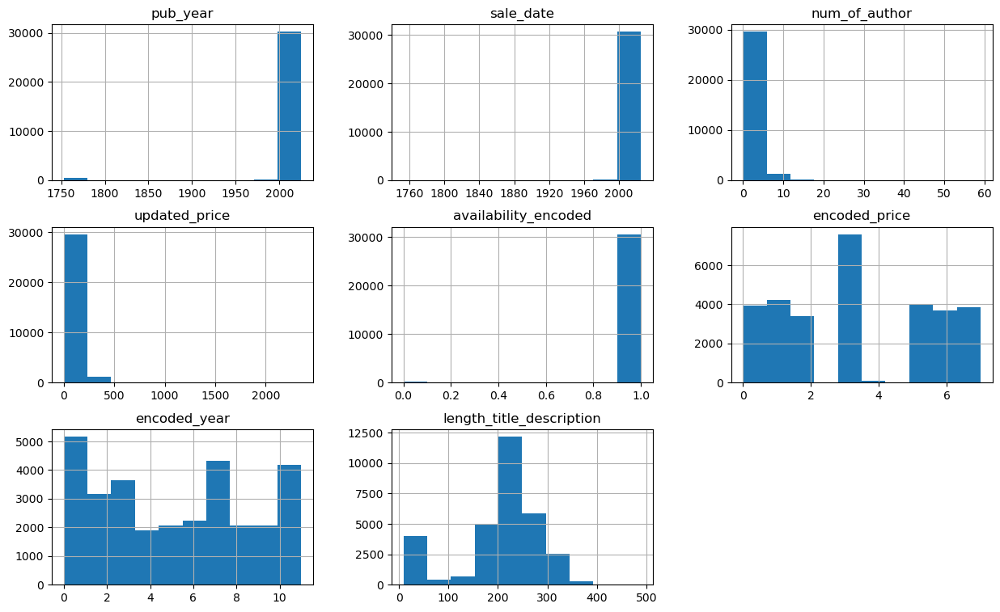

In [180]:
df_5.hist(figsize=(15,9),bins=10)
# plt.figure(figsize=(15,8))
plt.show()

# Step 7: Handling_outliers 

In [181]:
#flooring and cap method 

df1=df.copy()

df1.SalePrice=np.where(df1.SalePrice<floor,floor,df1.SalePrice)
df1.SalePrice=np.where(df1.SalePrice>cap,cap,df1.SalePrice)

In [182]:
df_6=df_5.copy()

In [184]:
df_5_num

['pub_year',
 'num_of_author',
 'updated_price',
 'encoded_price',
 'encoded_year',
 'length_title_description']

In [189]:
out

{'pub_year': {'IQR': 8.0,
  'Lower_whisker': 2000.0,
  'quater1': 2012.0,
  'mid': 2016.0,
  'quater3': 2020.0,
  'upper_whisker': 2024.0},
 'num_of_author': {'IQR': 2.0,
  'Lower_whisker': -2.0,
  'quater1': 1.0,
  'mid': 2.0,
  'quater3': 3.0,
  'upper_whisker': 4.0},
 'updated_price': {'IQR': 44.45,
  'Lower_whisker': -16.69,
  'quater1': 49.99,
  'mid': 72.64,
  'quater3': 94.44,
  'upper_whisker': 116.67},
 'encoded_price': {'IQR': 4.0,
  'Lower_whisker': -5.0,
  'quater1': 1.0,
  'mid': 3.0,
  'quater3': 5.0,
  'upper_whisker': 7.0},
 'encoded_year': {'IQR': 6.0,
  'Lower_whisker': -7.0,
  'quater1': 2.0,
  'mid': 5.0,
  'quater3': 8.0,
  'upper_whisker': 11.0},
 'length_title_description': {'IQR': 66.0,
  'Lower_whisker': 90.0,
  'quater1': 189.0,
  'mid': 220.0,
  'quater3': 255.0,
  'upper_whisker': 288.0}}

In [190]:
df_6[df_6.pub_year<2000]

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description
271,Pearson Education,1994,1994-10-31,4,design patterns,nbsp capturing wealth experience design object...,64.64,NaN,1,3.0,0,"[nbsp, capturing, wealth, experience, design, ...","[design, designer, nbsp, capturing, wealth, ex...",290
351,Pearson Education,1995,1995-08-02,1,mythical man month the,first mythical month software engineer bookshe...,47.13,2,1,1.0,0,"[first, mythical, month, software, engineer, b...","[software, engineer, nbsp, first, mythical, mo...",230
372,O'Reilly Media,1997,2010-10-19,2,sed awk,sed awk describes text processing programs mai...,56.99,2,1,2.0,0,"[sed, awk, describes, text, processing, progra...","[sed, text, processing, stream, might, awk, de...",243
401,Pearson Education,1988,1988-03-22,2,programming language,full text downloaded computer ebooks search ke...,72.72,2,1,4.0,0,"[full, text, downloaded, computer, ebooks, sea...","[downloaded, computer, ebooks, note, available...",243
421,Pearson Education,1994,1994-02-28,3,concrete mathematics,concrete mathematics blending continuous discr...,96.96,2,1,6.0,0,"[concrete, mathematics, blending, continuous, ...","[mathematics, nbsp, mathematical, concrete, bl...",279
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23342,World Scientific Publishing Company,1998,1998-08-14,3,neural networks and expert systems in medicine...,interest medical expert systems neural network...,60.61,NaN,1,2.0,0,"[interest, medical, expert, system, neural, ne...","[healthcare, interest, medical, expert, system...",369
23343,World Scientific Publishing Company,1993,1993-06-14,2,gis technology and applications proceedings of...,past decade witnessed sharp increase use geogr...,70.04,NaN,1,3.0,0,"[past, decade, witnessed, sharp, increase, use...","[gi, paper, past, decade, witnessed, sharp, in...",344
23344,World Scientific Publishing Company,1989,1989-12-01,3,learning and recognition modern approach proce...,proceedings cover wide range topics theoretica...,74.08,NaN,1,5.0,0,"[proceeding, cover, wide, range, topic, theore...","[neural, net, cellular, automaton, proceeding,...",405
23369,World Scientific Publishing Company,1992,1992-06-08,5,progress in image analysis and processing ii p...,book presents reports known experts recent res...,82.16,NaN,1,5.0,0,"[book, present, report, known, expert, recent,...","[analysis, application, book, present, report,...",367


In [234]:
def fol_cap(dataframe):
#     print(dataframe)
    for col in df_5_num:
        print(col)
        dataframe[col]=np.where(dataframe[col]<out[col]['Lower_whisker'],out[col]['Lower_whisker'],dataframe[col])
        dataframe[col]=np.where(dataframe[col]>out[col]['upper_whisker'],out[col]['upper_whisker'],dataframe[col])

In [235]:
fol_cap(df_6)

                        publisher  pub_year  sale_date  num_of_author  \
0                  O'Reilly Media    2024.0 2024-01-10            1.0   
1                  O'Reilly Media    2023.0 2023-10-17            1.0   
2                  O'Reilly Media    2022.0 2022-10-04            1.0   
3                  O'Reilly Media    2017.0 2017-03-16            1.0   
4               Pearson Education    2023.0 2023-10-18            1.0   
...                           ...       ...        ...            ...   
39977  Springer Berlin Heidelberg    2006.0 2006-12-12            3.0   
39978  Springer Berlin Heidelberg    2006.0 2006-07-25            4.0   
39979  Springer Berlin Heidelberg    2008.0 2008-02-20            2.0   
39988  Springer Berlin Heidelberg    2006.0 2006-07-25            3.0   
39989  Springer Berlin Heidelberg    2006.0 2006-08-29            2.0   

                                         processed_title  \
0                                            learning go   
1  

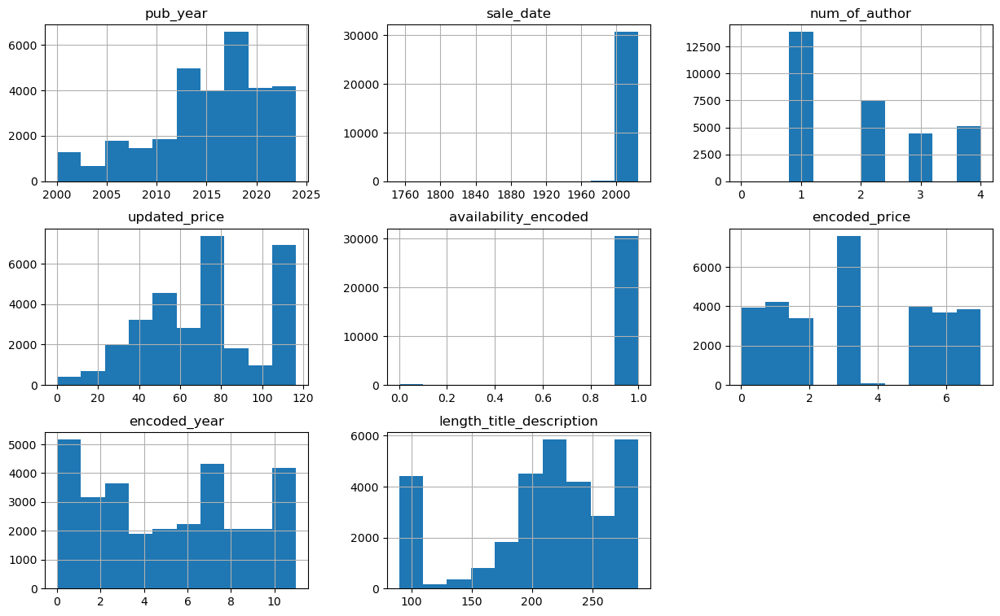

In [236]:
df_6.hist(figsize=(15,9),bins=10)
# plt.figure(figsize=(15,8))
plt.show()

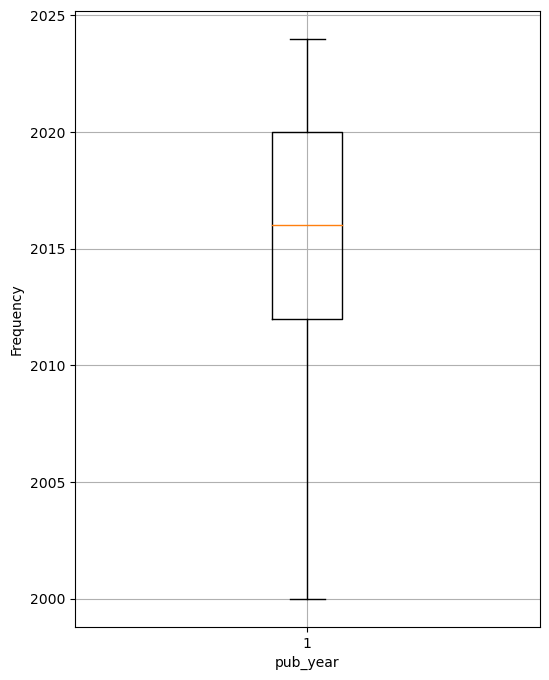

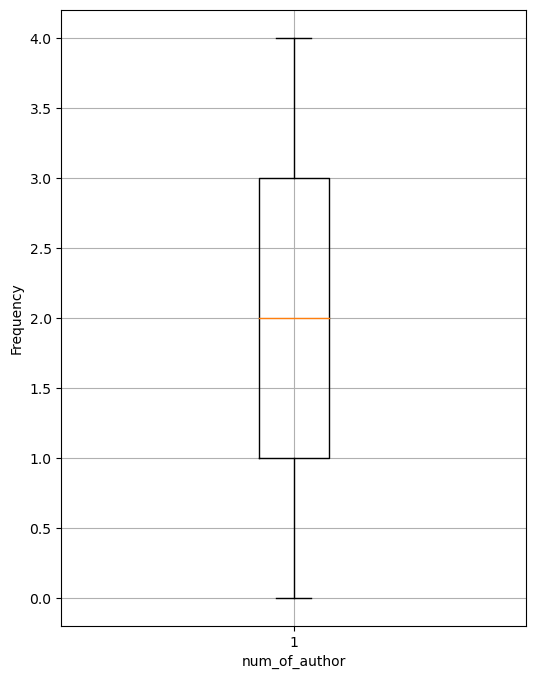

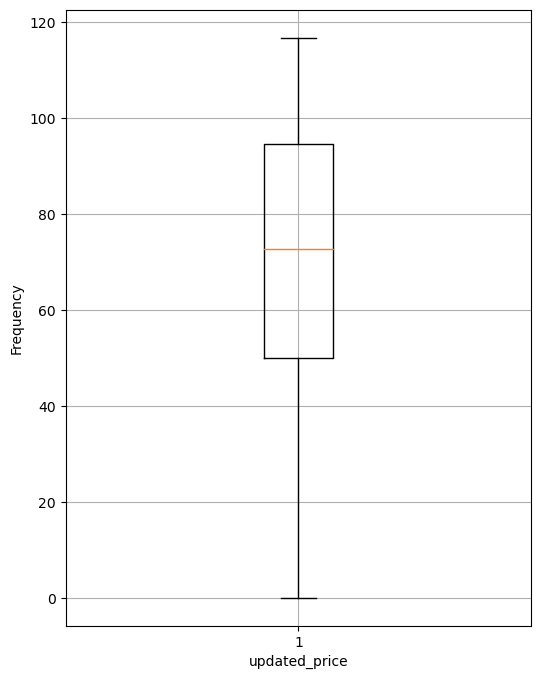

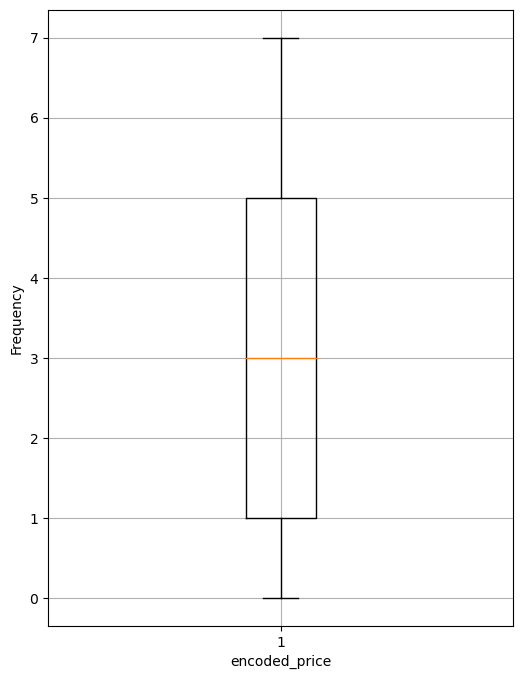

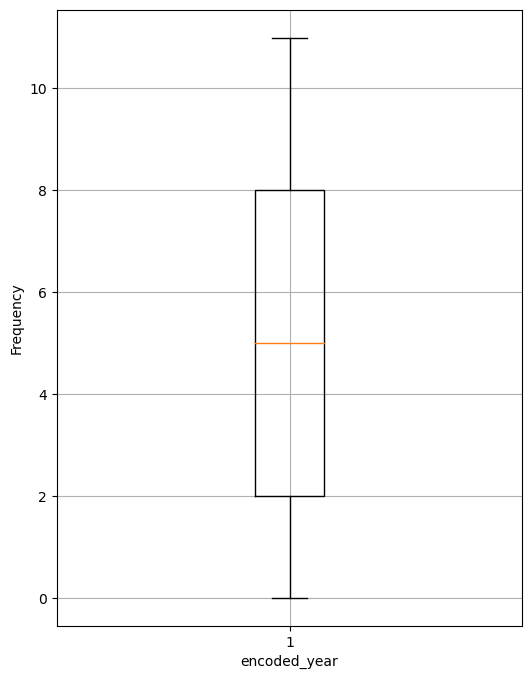

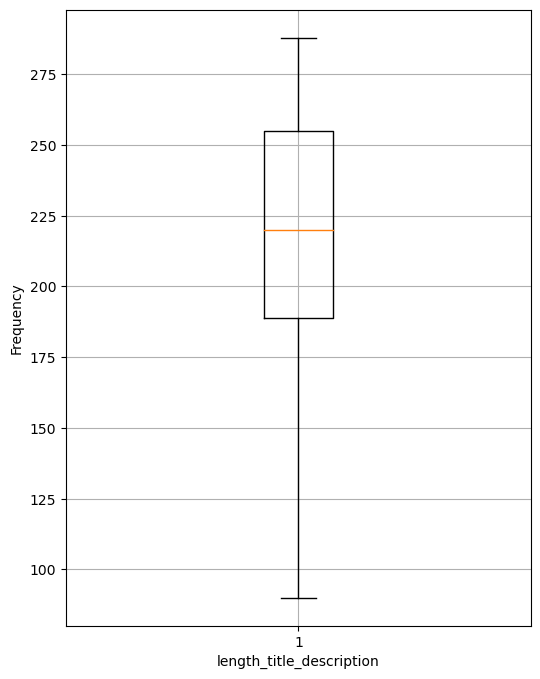

In [237]:
box_plot(df_6)

In [241]:

print(get_skew(df_6))
print("="*50+'\n')
print(get_kurtosis(df_6))

pub_year                   -0.782614
num_of_author               0.658426
updated_price               0.100238
encoded_price               0.160137
encoded_year                0.074889
length_title_description   -0.782909
dtype: float64

pub_year                    0.008045
num_of_author              -0.997836
updated_price              -0.836844
encoded_price              -1.222470
encoded_year               -1.176155
length_title_description   -0.241582
dtype: float64


In [238]:
#write analysis for the floor and cap method --> df_6

In [239]:
#trim

In [240]:
#littel tricky one, but we can handle one by one slowly

In [251]:
df_7=df_5.copy()

In [252]:
df_5_num

['pub_year',
 'num_of_author',
 'updated_price',
 'encoded_price',
 'encoded_year',
 'length_title_description']

In [253]:
df_7.shape

(30834, 14)

In [254]:
df_7=df_7[(df_7.pub_year>out['pub_year']['Lower_whisker']) & (df_7.pub_year<out['pub_year']['upper_whisker'])]

In [255]:
df_7.shape

(29630, 14)

In [256]:
df_7=df_7[(df_7.num_of_author>out['num_of_author']['Lower_whisker']) & (df_7.num_of_author<out['num_of_author']['upper_whisker'])]

In [257]:
df_7.shape

(24618, 14)

In [258]:
df_7=df_7[(df_7.updated_price>out['updated_price']['Lower_whisker']) & (df_7.updated_price<out['updated_price']['upper_whisker'])]

In [259]:
df_7.shape

(20349, 14)

In [260]:
df_7=df_7[(df_7.length_title_description>out['length_title_description']['Lower_whisker']) & (df_7.length_title_description<out['length_title_description']['upper_whisker'])]

In [261]:
df_7.shape

(13921, 14)

In [264]:
#we didn't use the  'encoded_price', 'encoded_year' as it is already trimmed properly

#16913 data is trimmed with 54%

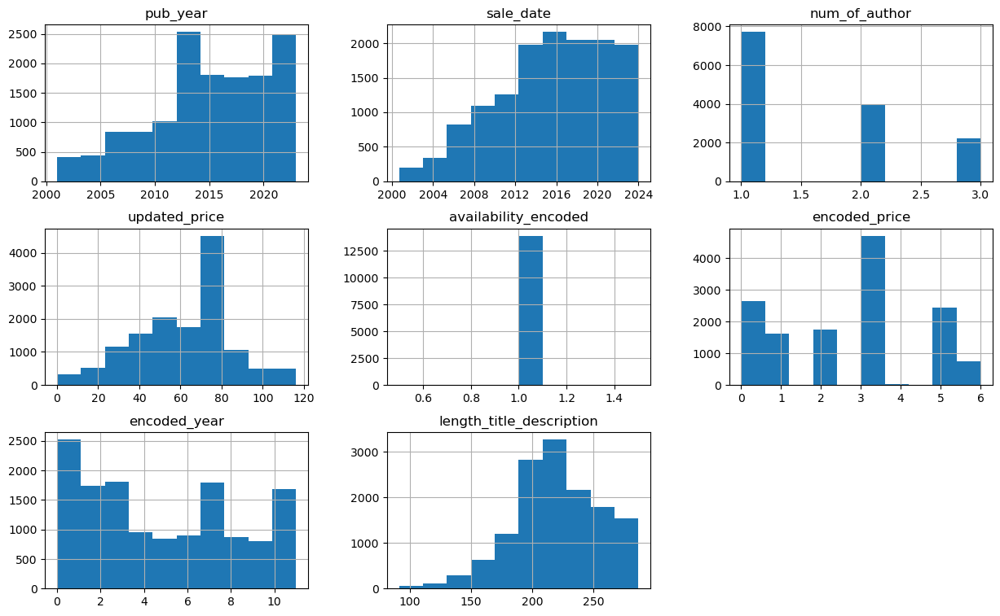

In [265]:
df_7.hist(figsize=(15,9),bins=10)
# plt.figure(figsize=(15,8))
plt.show()

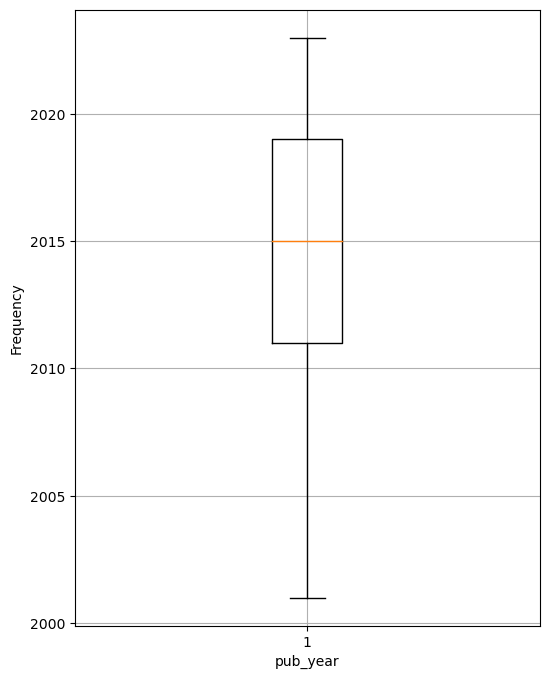

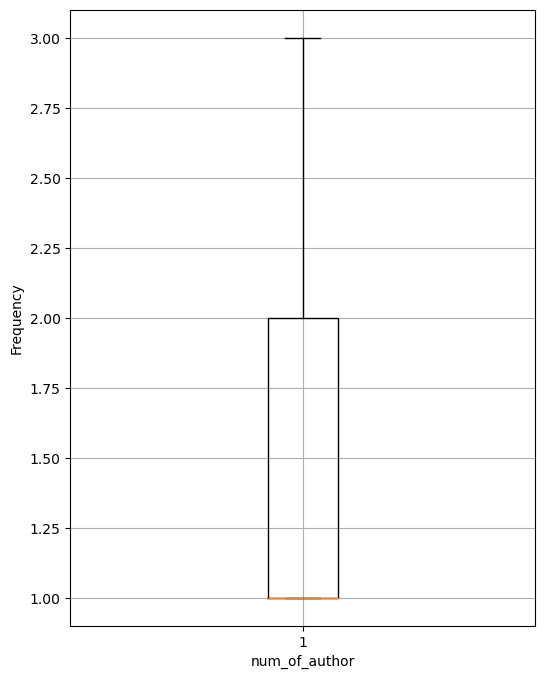

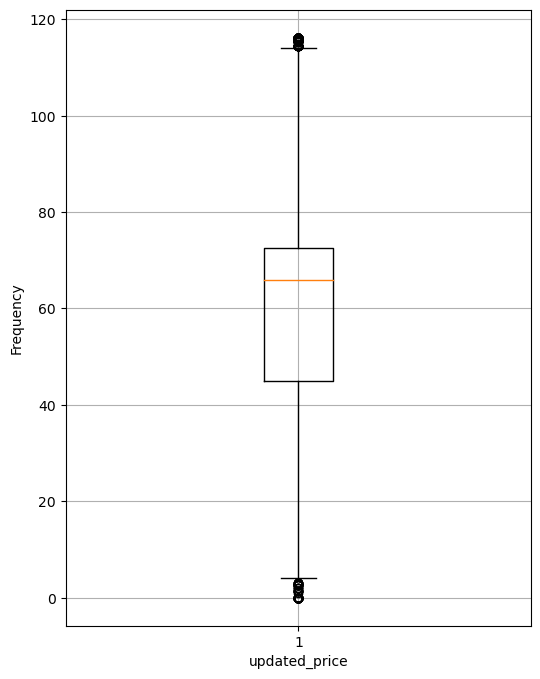

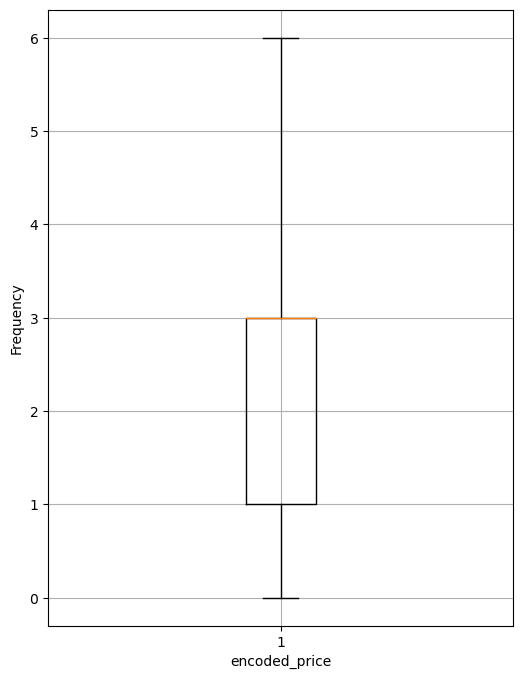

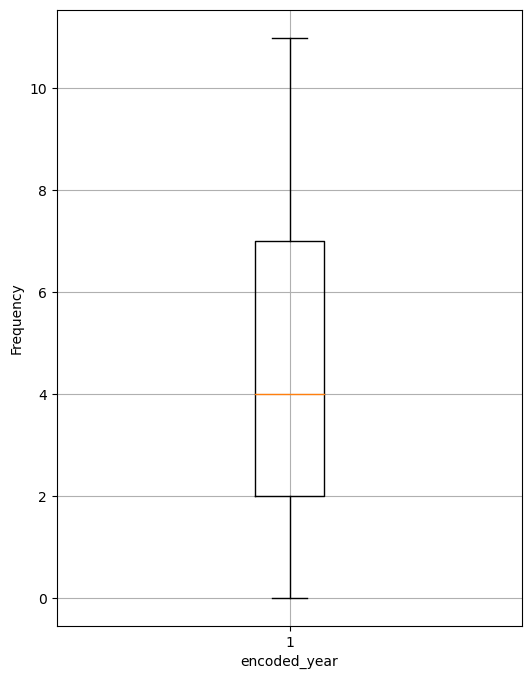

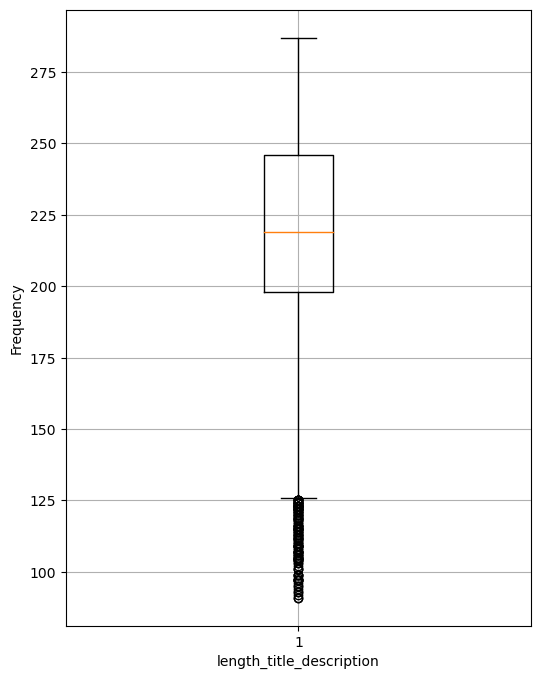

In [266]:
box_plot(df_7)

In [267]:

print(get_skew(df_7))
print("="*50+'\n')
print(get_kurtosis(df_6))

pub_year                   -0.477390
num_of_author               0.782387
updated_price              -0.261810
encoded_price               0.143376
encoded_year                0.227696
length_title_description   -0.310286
dtype: float64

pub_year                    0.008045
num_of_author              -0.997836
updated_price              -0.836844
encoded_price              -1.222470
encoded_year               -1.176155
length_title_description   -0.241582
dtype: float64


In [268]:
#log transform

In [269]:
df_8=df_5.copy()

In [270]:
df_8.describe()

,pub_year,num_of_author,updated_price,availability_encoded,encoded_price,encoded_year,length_title_description
count,30834.000000,30834.000000,30745.000000,30834.000000,30745.000000,30834.000000,30834.000000
mean,2011.657586,2.219044,87.499480,0.992054,3.356188,5.179931,206.525783
std,31.565710,1.715887,69.245046,0.088786,2.298986,3.367980,80.759759
min,1753.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000
25%,2012.000000,1.000000,49.990000,1.000000,1.000000,2.000000,189.000000
50%,2016.000000,2.000000,72.640000,1.000000,3.000000,5.000000,220.000000
75%,2020.000000,3.000000,94.440000,1.000000,5.000000,8.000000,255.000000
max,2025.000000,59.000000,2353.370000,1.000000,7.000000,11.000000,489.000000


In [272]:
def log_(dataframe):
    for col in df_5_num:
        dataframe[col] = dataframe[col].map(lambda i: np.log(i) if i>0 else 0)


In [273]:
log_(df_8)

In [274]:
df_8.describe()

,pub_year,num_of_author,updated_price,availability_encoded,encoded_price,encoded_year,length_title_description
count,30834.000000,30834.000000,30834.000000,30834.000000,30834.000000,30834.000000,30834.000000
mean,7.606580,0.588891,4.240110,0.992054,1.016548,1.401732,5.170537
std,0.016745,0.613649,0.720517,0.088786,0.717381,0.800624,0.698902
min,7.469084,0.000000,-0.010050,0.000000,0.000000,0.000000,2.197225
25%,7.606885,0.000000,3.911823,1.000000,0.000000,0.693147,5.241747
50%,7.608871,0.693147,4.285516,1.000000,1.098612,1.609438,5.393628
75%,7.610853,1.098612,4.547965,1.000000,1.609438,2.079442,5.541264
max,7.613325,4.077537,7.763604,1.000000,1.945910,2.397895,6.192362


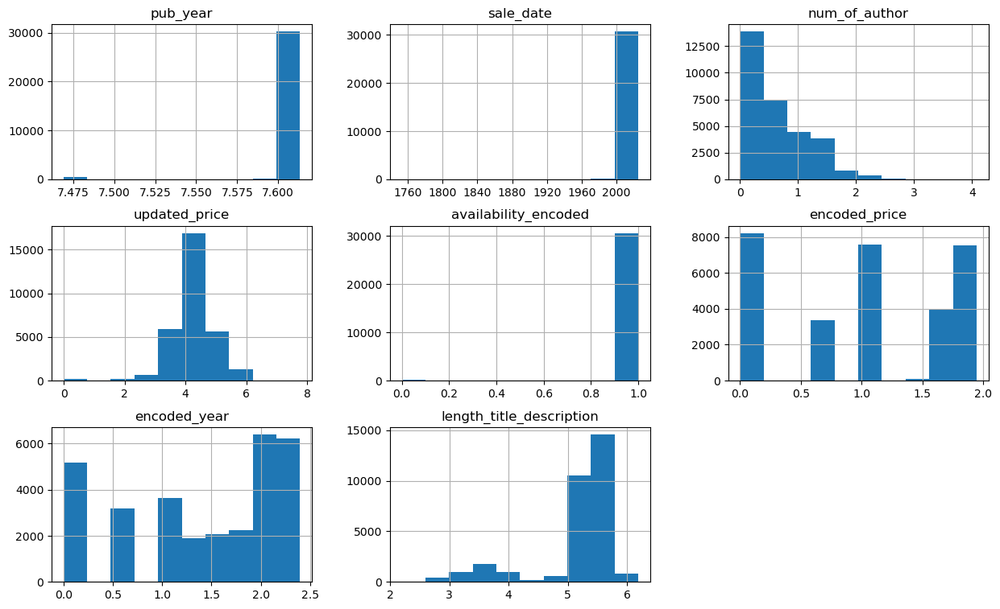

In [275]:
df_8.hist(figsize=(15,9),bins=10)
# plt.figure(figsize=(15,8))
plt.show()

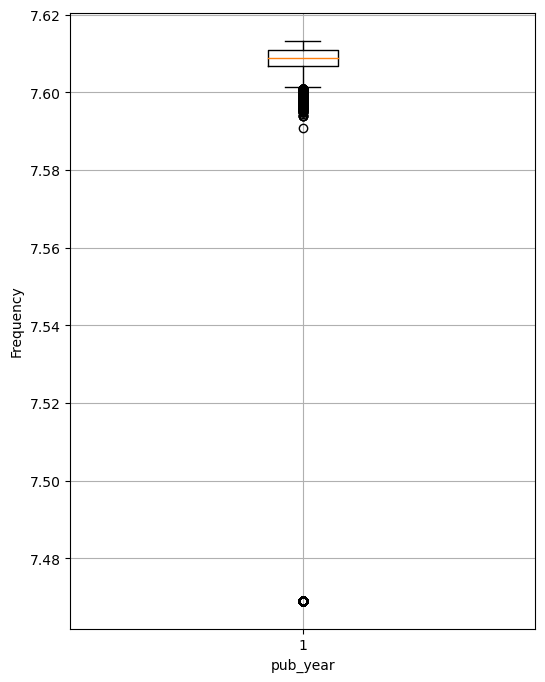

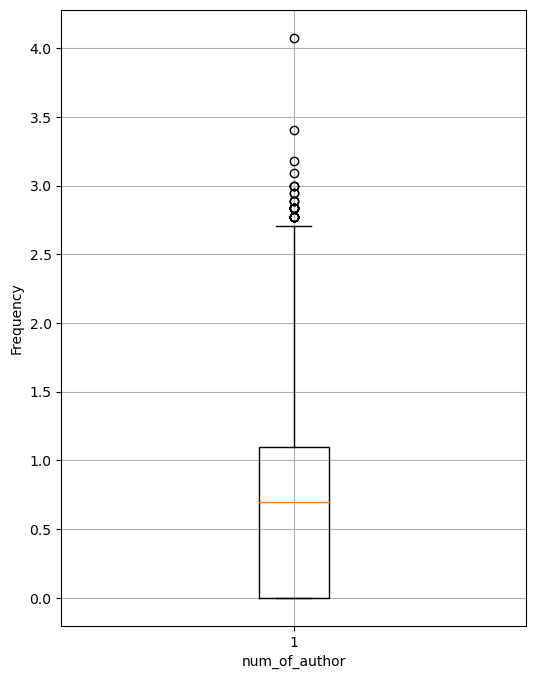

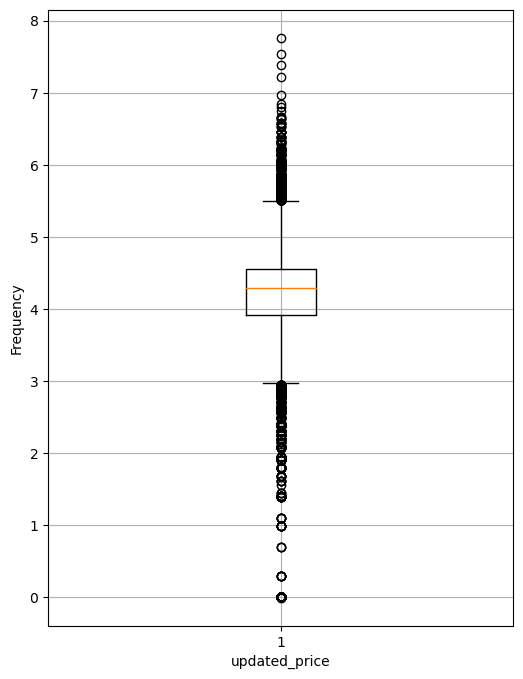

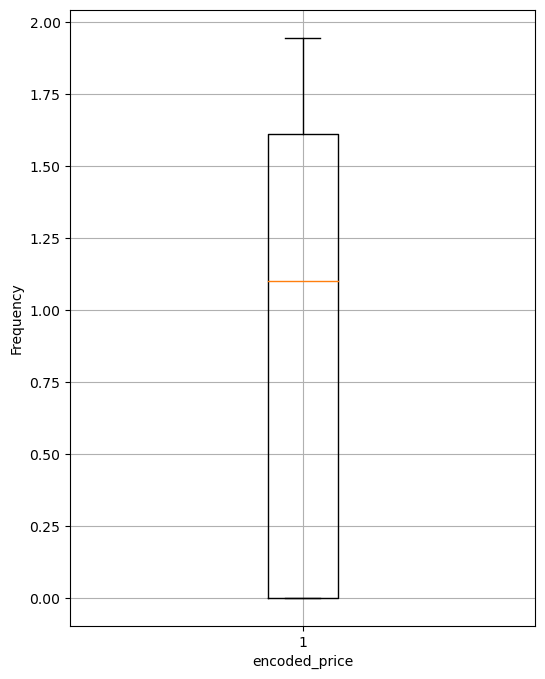

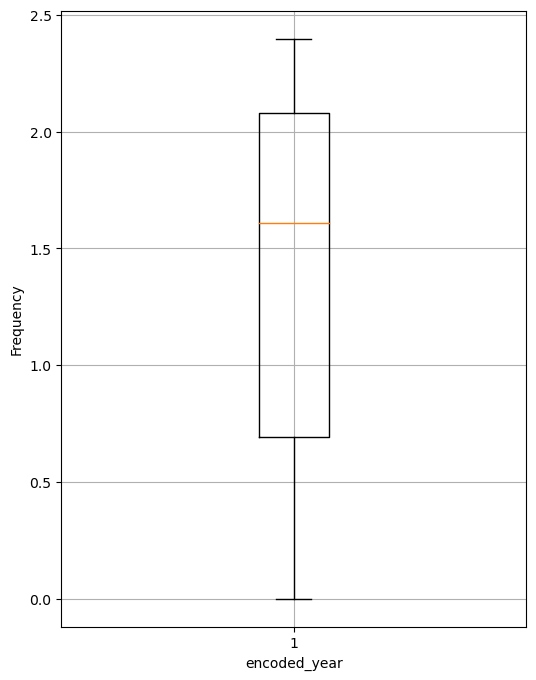

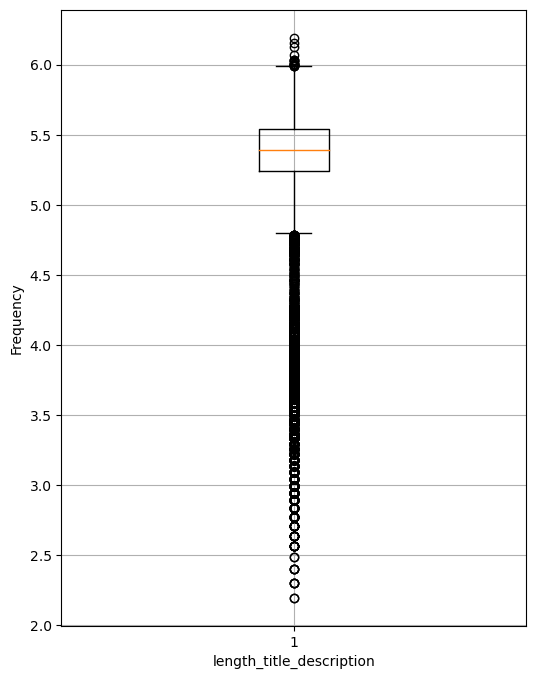

In [276]:
box_plot(df_8)

In [277]:

print(get_skew(df_8))
print("="*50+'\n')
print(get_kurtosis(df_6))

pub_year                   -7.857637
num_of_author               0.620890
updated_price              -1.306162
encoded_price              -0.273348
encoded_year               -0.595456
length_title_description   -1.953618
dtype: float64

pub_year                    0.008045
num_of_author              -0.997836
updated_price              -0.836844
encoded_price              -1.222470
encoded_year               -1.176155
length_title_description   -0.241582
dtype: float64


In [278]:
#in report we need to discuss the results properly 

In [280]:
df_5['key'] = df_5['key_words'].apply(lambda x: ' '.join(x))

In [282]:
df_5.head()

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description,key
0,O'Reilly Media,2024,2024-01-10,1,learning go,go rapidly become preferred language building ...,71.99,2,1,3.0,11,"[go, rapidly, become, preferred, language, bui...","[go, language, tutorial, teach, developer, rap...",256,go rapidly become preferred language building ...
1,O'Reilly Media,2023,2023-10-17,1,tidy first,tidying messy software means breaking code mak...,42.99,NaN,1,1.0,11,"[tidying, messy, software, mean, breaking, cod...","[software, code, make, tidying, messy, mean, b...",240,tidying messy software mean breaking code make...
2,O'Reilly Media,2022,2022-10-04,1,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,96.99,3,1,6.0,10,"[recent, series, breakthrough, deep, learning,...","[learning, recent, series, breakthrough, deep,...",330,recent series breakthrough deep learning boost...
3,O'Reilly Media,2017,2017-03-16,1,designing data intensive applications,data center many challenges system design toda...,67.99,NaN,1,3.0,6,"[data, center, many, challenge, system, design...","[data, center, many, challenge, system, design...",301,data center many challenge system design today...
4,Pearson Education,2023,2023-10-18,1,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,53.86,NaN,1,2.0,11,"[prepare, microsoft, exam, m, help, demonstrat...","[microsoft, prepare, exam, m, help, demonstrat...",220,prepare microsoft exam m help demonstrate real...


In [284]:
vectorizer = TfidfVectorizer()

In [285]:
vec = vectorizer.fit_transform(df_5['key'])


In [286]:
vec

<30834x27057 sparse matrix of type '<class 'numpy.float64'>'
	with 582346 stored elements in Compressed Sparse Row format>

In [288]:
similarity_check= cosine_similarity(vec, vec)
final_df = pd.DataFrame(similarity_check)
final_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [290]:
sse=[]
kmeans_params = {
    'init': 'random',
    'n_init': 10,
    'max_iter': 30,
    'random_state': 42
}
for k in range(1,5):
    print(f'Cluster {k}/5')
#     kmeans = KMeans(n_clusters=k, **kmeans_params)
    
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(similarity_check)
    sse.append(kmeans.inertia_)
    clear_output(wait=True)
locator = KneeLocator(range(1,5), sse, curve='convex', direction='decreasing')
print('Best cluster for KMeans:', locator.elbow)

Best cluster for KMeans: 2


In [291]:
# kmeans = KMeans(n_clusters=locator.elbow, **kmeans_params)
kmeans = KMeans(n_clusters=locator.elbow)
kmeans.fit(similarity_check)
df_5['cluster'] = kmeans.labels_
df_5.head()

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description,key,cluster
0,O'Reilly Media,2024,2024-01-10,1,learning go,go rapidly become preferred language building ...,71.99,2,1,3.0,11,"[go, rapidly, become, preferred, language, bui...","[go, language, tutorial, teach, developer, rap...",256,go rapidly become preferred language building ...,0
1,O'Reilly Media,2023,2023-10-17,1,tidy first,tidying messy software means breaking code mak...,42.99,NaN,1,1.0,11,"[tidying, messy, software, mean, breaking, cod...","[software, code, make, tidying, messy, mean, b...",240,tidying messy software mean breaking code make...,0
2,O'Reilly Media,2022,2022-10-04,1,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,96.99,3,1,6.0,10,"[recent, series, breakthrough, deep, learning,...","[learning, recent, series, breakthrough, deep,...",330,recent series breakthrough deep learning boost...,0
3,O'Reilly Media,2017,2017-03-16,1,designing data intensive applications,data center many challenges system design toda...,67.99,NaN,1,3.0,6,"[data, center, many, challenge, system, design...","[data, center, many, challenge, system, design...",301,data center many challenge system design today...,0
4,Pearson Education,2023,2023-10-18,1,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,53.86,NaN,1,2.0,11,"[prepare, microsoft, exam, m, help, demonstrat...","[microsoft, prepare, exam, m, help, demonstrat...",220,prepare microsoft exam m help demonstrate real...,0


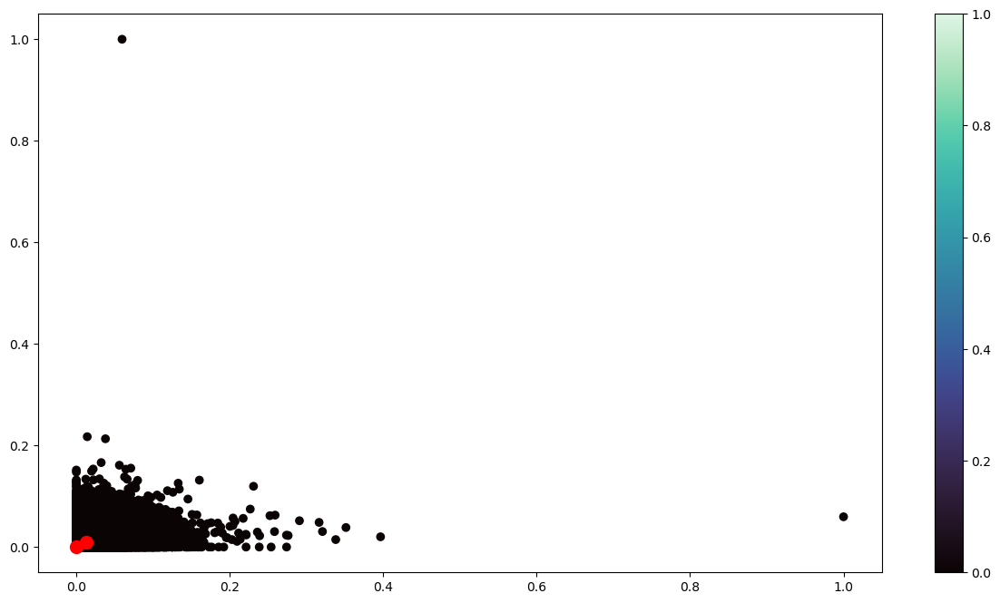

In [292]:
plt.figure(figsize=(15,8))
output = plt.scatter(similarity_check[:,0], similarity_check[:,1], c=df_5.cluster, marker='o', alpha=1, cmap='mako')
centers = kmeans.cluster_centers_
plt.scatter(centers[:,0], centers[:,1], c='red', s=100, alpha=1 , marker='o')
plt.colorbar(output)
plt.show()

In [293]:
cluster_1 = df_5.loc[df_5['cluster'] == 1, :]
cluster_1.shape

(4237, 16)

In [294]:
cluster_0 = df_5.loc[df_5['cluster'] == 0, :]
cluster_0.shape

(26597, 16)

In [295]:
check = df_5.sample(1, random_state=42)
check

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description,key,cluster
32801,Springer International Publishing,2016,2016-05-23,9,communication technologies for vehicles,book constitutes proceedings th international ...,72.64,NaN,1,3.0,5,"[book, constitutes, proceeding, th, internatio...","[net, book, constitutes, proceeding, th, inter...",221,book constitutes proceeding th international w...,0


In [296]:
kmeans = KMeans(n_clusters=15)
kmeans.fit(similarity_check)
df_5['cluster_k_15'] = kmeans.labels_
df_5.head()

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description,key,cluster,cluster_k_15
0,O'Reilly Media,2024,2024-01-10,1,learning go,go rapidly become preferred language building ...,71.99,2,1,3.0,11,"[go, rapidly, become, preferred, language, bui...","[go, language, tutorial, teach, developer, rap...",256,go rapidly become preferred language building ...,0,2
1,O'Reilly Media,2023,2023-10-17,1,tidy first,tidying messy software means breaking code mak...,42.99,NaN,1,1.0,11,"[tidying, messy, software, mean, breaking, cod...","[software, code, make, tidying, messy, mean, b...",240,tidying messy software mean breaking code make...,0,2
2,O'Reilly Media,2022,2022-10-04,1,hands on machine learning with scikit learn ke...,recent series breakthroughs deep learning boos...,96.99,3,1,6.0,10,"[recent, series, breakthrough, deep, learning,...","[learning, recent, series, breakthrough, deep,...",330,recent series breakthrough deep learning boost...,0,14
3,O'Reilly Media,2017,2017-03-16,1,designing data intensive applications,data center many challenges system design toda...,67.99,NaN,1,3.0,6,"[data, center, many, challenge, system, design...","[data, center, many, challenge, system, design...",301,data center many challenge system design today...,0,11
4,Pearson Education,2023,2023-10-18,1,exam ref ms microsoft administrator,prepare microsoft exam ms help demonstrate rea...,53.86,NaN,1,2.0,11,"[prepare, microsoft, exam, m, help, demonstrat...","[microsoft, prepare, exam, m, help, demonstrat...",220,prepare microsoft exam m help demonstrate real...,0,4


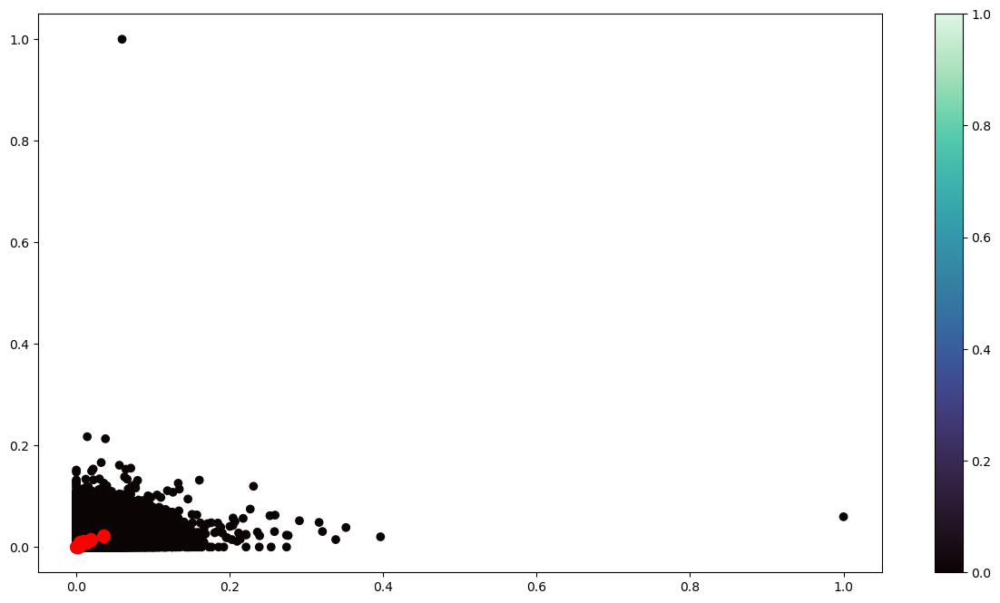

In [297]:
plt.figure(figsize=(15,8))
output = plt.scatter(similarity_check[:,0], similarity_check[:,1], c=df_5.cluster, marker='o', alpha=1, cmap='mako')
centers = kmeans.cluster_centers_
plt.scatter(centers[:,0], centers[:,1], c='red', s=100, alpha=1 , marker='o')
plt.colorbar(output)
plt.show()

In [298]:
cluster_1 = df_5.loc[df_5['cluster_k_15'] == 1, :]
cluster_1.shape

(4237, 17)

In [299]:
cluster_12 = df_5.loc[df_5['cluster_k_15'] == 12, :]
cluster_12.shape

(308, 17)

In [305]:
pd.options.display.max_columns = None

In [309]:
pd.set_option('display.max_colwidth', None)

In [308]:
cluster_12.head(5)

,publisher,pub_year,sale_date,num_of_author,processed_title,processed_description,updated_price,edition,availability_encoded,encoded_price,encoded_year,key_words,common_word,length_title_description,key,cluster,cluster_k_15
5128,Springer International Publishing,2023,2023-01-01,6,optimization learning algorithms and applications,book constitutes proceedings nbsp second international conference optimization learning algorithms applications ol held nbsp bragança portugal october full papers short papers,159.83,NaN,1,7.0,11,"[book, constitutes, proceeding, nbsp, second, international, conference, optimization, learning, algorithm, application, ol, held, nbsp, bragança, portugal, october, full, paper, short, paper]","[nbsp, paper, book, constitutes, proceeding, second, international, conference, optimization, learning, algorithm, application, ol, held, bragança, portugal, october, full, short]",224,book constitutes proceeding nbsp second international conference optimization learning algorithm application ol held nbsp bragança portugal october full paper short paper,0,12
10456,Springer International Publishing,2015,2015-12-18,4,agents and artificial intelligence,book constitutes thoroughly refereed post conference nbsp proceedings th international conference agents artificial nbsp intelligence icaart held lisbon portugal january revised full papers,72.64,NaN,1,3.0,4,"[book, constitutes, thoroughly, refereed, post, conference, nbsp, proceeding, th, international, conference, agent, artificial, nbsp, intelligence, icaart, held, lisbon, portugal, january, revised, full, paper]","[conference, nbsp, book, constitutes, thoroughly, refereed, post, proceeding, th, international, agent, artificial, intelligence, icaart, held, lisbon, portugal, january, revised, full, paper]",223,book constitutes thoroughly refereed post conference nbsp proceeding th international conference agent artificial nbsp intelligence icaart held lisbon portugal january revised full paper,0,12
26347,Springer International Publishing,2022,2022-10-27,2,doctoral symposium on information and communication technologies,book constitutes refereed proceedings nbsp second doctoral symposium information communication technologies dsict held manta ecuador october nbsp full papers thoroughly reviewed selected,101.70,NaN,1,6.0,10,"[book, constitutes, refereed, proceeding, nbsp, second, doctoral, symposium, information, communication, technology, dsict, held, manta, ecuador, october, nbsp, full, paper, thoroughly, reviewed, selected]","[nbsp, book, constitutes, refereed, proceeding, second, doctoral, symposium, information, communication, technology, dsict, held, manta, ecuador, october, full, paper, thoroughly, reviewed, selected]",250,book constitutes refereed proceeding nbsp second doctoral symposium information communication technology dsict held manta ecuador october nbsp full paper thoroughly reviewed selected,0,12
26349,Springer International Publishing,2022,2022-10-29,6,the future of heritage science and technologies ict and digital heritage,volume constitutes refereed proceedings nbsp third international conference future heritage science technologies florence heri tech held florence italy nbsp nbsp papers presented,123.50,NaN,1,6.0,10,"[volume, constitutes, refereed, proceeding, nbsp, third, international, conference, future, heritage, science, technology, florence, heri, tech, held, florence, italy, nbsp, nbsp, paper, presented]","[nbsp, florence, volume, constitutes, refereed, proceeding, third, international, conference, future, heritage, science, technology, heri, tech, held, italy, paper, presented]",250,volume constitutes refereed proceeding nbsp third international conference future heritage science technology florence heri tech held florence italy nbsp nbsp paper presented,0,12
26363,Springer International Publishing,2022,2022-11-20,3,intelligent data engineering and automated learning ideal,book constitutes refereed proceedings rd nbsp international conference 

In [310]:
#not added the t-SNE method here as it will your precisious time !! lol